# Combining classification with regression


As outlined in the "sktime_modelling" notebook, a binary classifier predicting the occurrence of nonzero driver needs was supposed to be trained that would first predict whether drivers would be required at all, after which a regressor would determine the actual number of required standby drivers. 

Naturally, the choice for which kind of classifier to use should be made in accordance with the business objectives.
While proper performance is obviously desired, high model interpretability and explainability appears to be just as important for the client.

Thus, the first classifier to be considered was Microsoft's Explainable Boosting Machine (EBM) which is available in the interpretML package (https://interpret.ml/docs/ebm.html).
EBMs are generalized additive models (GAMs).
Therefore, they belong to the class of glassbox models which are inherently interpretable.
In terms of accuracy, EBMs are comparable to state-of-the-art machine learning methods like Random Forest and Boosted Trees according to its developers (https://interpret.ml/docs/ebm.html).
As further benefits, the algorithm naturally handles categorical features, and automatically detects which interaction effects to include in the model, which facilitates the use of the EBM classifier.
Moreover, the interpretML package seamlessly delivers global and local model explainations for its EBMs, thereby truly making EBMs an attractive choice for the current project. 

To quickly test whether EBMs would indeed perform well in the current project, default EBM settings were tested first using all features that can be seen below to classify on which days drivers would be required. 
Training and testing procedures were the same as the ones used for the regressors, i.e., expanding window 12-month cross validation with training splits ending on the 15th of each month and testing splits starting on the first of the following month.
In the following, different decision thresholds were used to binarize the predicted probabilites for the two classes into predictions of whether drivers would be needed or not.
The binary predictions were then used to gate the predictions of previously tested TBATS regressors that would have a rather large buffer in their predictions for the number of standby drivers needed. 
When the probability returned from the classifier was below the decision threshold, the number of predicted standby drivers was set to zero.

During experimentation (data not shown), it quickly became apparent that the approach of combining such an EBM classifier with an overpredicting TBATS regressor would be able to improve all business metrics by a magnitude that would depend on the tuning of all parameters and hyperparameters involved.

Thus, the decision was made to follow up on this approach and perform some optimization.

So far, the EBM classifier had been used with default settings.
Furthermore, the feature selection method was to manually pick different features that made sense given the EDA, such as the day of the month, the day of the week, or the month name. 
Additionally, all features that are commonly used when analyzing time series, such as quarter, is_weekend, season etc. were naively included in the modeling process when the best model at that time was identified.
Naturally, there might be redundancy in features such as "season" and "quarter".
Hence, it was attempted whether more sophisticated feature selection approaches and optimized EBM parameters would improve  model performance assessed on the level of the business metrics.

In [23]:
import pandas as pd
import holidays
import itertools
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.compose import make_column_transformer
import matplotlib.pyplot as plt
from sktime.performance_metrics.forecasting import make_forecasting_scorer
import numpy as np
from imblearn.over_sampling import SMOTE, ADASYN, BorderlineSMOTE, RandomOverSampler, SMOTEN
from sktime.forecasting.tbats import TBATS

In [24]:


pd.set_option('display.max_columns', None)

%matplotlib inline

data = pd.read_csv("sickness_table.csv")
data.drop(data.columns[0], axis = 1, inplace = True)

data["date"] = pd.to_datetime(data["date"])
#data.set_index("date", inplace = True)

data["sby_required"] = data["sby_need"] > 0
data["day_of_month"] = data["date"].dt.day
data["weekday"] = data["date"].dt.day_of_week
data["weekday_name"] = data["date"].dt.day_name()
data["month"] = data["date"].dt.month
data["month_name"] = data["date"].dt.month_name()
data["year"] = data["date"].dt.year
data["is_weekend"] = (data["weekday_name"] == "Saturday") | (data["weekday_name"] == "Sunday")

# create column indicating public holidays
holidays_berlin = holidays.DE(subdiv = "BE", years = [2016, 2017, 2018, 2019])

#initiate column
data["is_holiday"] = False

#set true if date is holiday
for index in range(len(data["date"])):
    if data.loc[index, "date"] in holidays_berlin:
        data.loc[index, "is_holiday"] = True

#crate column indicating school holidays
holidays_school = []
holidays_school.append(pd.date_range("2016-04-01", periods = 1)) #Osterferien
holidays_school.append(pd.date_range("2016-05-06", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2016-05-17", periods = 2)) #Pfingstferien
holidays_school.append(pd.date_range("2016-07-21", periods = 2)) #Sommerferien
holidays_school.append(pd.date_range("2016-07-25", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-01", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-01", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-08", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-15", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-22", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-08-29", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2016-10-17", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2016-10-24", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2016-12-23", periods = 1)) #Weihnachtsferien
holidays_school.append(pd.date_range("2016-12-27", periods = 4)) #Weihnachtsferien
holidays_school.append(pd.date_range("2017-01-02", periods = 2)) #Weihnachtsferien
holidays_school.append(pd.date_range("2017-01-30", periods = 5)) #Winterferien
holidays_school.append(pd.date_range("2017-04-10", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2017-04-18", periods = 1)) #Osterferien
holidays_school.append(pd.date_range("2017-05-24", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2017-05-26", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2017-06-06", periods = 4)) #Pfingstferien
holidays_school.append(pd.date_range("2017-07-20", periods = 1)) #Sommerferien
holidays_school.append(pd.date_range("2017-07-24", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-07-31", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-01", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-07", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-14", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-21", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-08-28", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2017-10-02", periods = 1)) #Herbstferien
holidays_school.append(pd.date_range("2017-10-23", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2017-10-30", periods = 1)) #Herbstferien
holidays_school.append(pd.date_range("2017-11-01", periods = 3)) #Herbstferien
holidays_school.append(pd.date_range("2017-12-21", periods = 2)) #Weihnachtsferien
holidays_school.append(pd.date_range("2017-12-27", periods = 3)) #Weihnachtsferien
holidays_school.append(pd.date_range("2018-01-02", periods = 1)) #Weihnachtsferien
holidays_school.append(pd.date_range("2018-02-05", periods = 5)) #Winterferien
holidays_school.append(pd.date_range("2018-03-26", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2018-04-06", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2018-04-30", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2018-05-11", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2018-05-22", periods = 1)) #Pfingstferien
holidays_school.append(pd.date_range("2018-07-05", periods = 2)) #Sommerferien
holidays_school.append(pd.date_range("2018-07-09", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-07-16", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-07-23", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-07-30", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-08-06", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-08-13", periods = 5)) #Sommerferien
holidays_school.append(pd.date_range("2018-10-22", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2018-10-29", periods = 5)) #Herbstferien
holidays_school.append(pd.date_range("2018-12-24", periods = 1)) #Weihnachtsferien
holidays_school.append(pd.date_range("2018-12-31", periods = 5)) #Weihnachtsferien
holidays_school.append(pd.date_range("2019-02-04", periods = 5)) #Winterferien
holidays_school.append(pd.date_range("2019-04-15", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2019-04-23", periods = 4)) #Osterferien
holidays_school.append(pd.date_range("2019-05-31", periods = 1)) #Osterferien

#flatten list
holidays_school = list(itertools.chain(*holidays_school))

data["is_school_holiday"] = False

#set true if date is holiday
for index in range(len(data["date"])):
    if data.loc[index, "date"] in holidays_school:
        data.loc[index, "is_school_holiday"] = True

data["kids_out_of_school"] = data["is_school_holiday"] | data["is_holiday"]

# quarter feature
data["quarter"] = 1
data.loc[(data["month"] > 3) & (data["month"] < 7), "quarter"] = 2
data.loc[(data["month"] > 6) & (data["month"] < 10), "quarter"] = 3
data.loc[data["month"] > 9, "quarter"] = 4

# season feature
data["season"] = "winter"
data.loc[(data["month"] >= 3) & (data["month"] <= 5), "season"] = "spring"
data.loc[(data["month"] >= 6) & (data["month"] <= 8), "season"] = "summer"
data.loc[(data["month"] >= 9) & (data["month"] <= 11), "season"] = "fall"


# week of the month count feature
data["week_num"] = 1
data.loc[(data["day_of_month"] > 7) & (data["day_of_month"] < 15), "week_num"] = 2
data.loc[(data["day_of_month"] > 14) & (data["day_of_month"] < 22), "week_num"] = 3
data.loc[(data["day_of_month"] > 21) & (data["day_of_month"] < 29), "week_num"] = 4
data.loc[data["day_of_month"] > 28, "week_num"] = 5

#add the "unique_id" column for statsforecast regressors
data["unique_id"] = "sby_need"

# rename for statsforecast input df format
data.rename({"date": "ds", "sby_need": "y"}, axis = 1, inplace=True)



data

,ds,n_sick,calls,n_duty,n_sby,y,dafted,sby_required,day_of_month,weekday,weekday_name,month,month_name,year,is_weekend,is_holiday,is_school_holiday,kids_out_of_school,quarter,season,week_num,unique_id
0,2016-04-01,73,8154.0,1700,90,4.0,0.0,True,1,4,Friday,4,April,2016,False,False,True,True,2,spring,1,sby_need
1,2016-04-02,64,8526.0,1700,90,70.0,0.0,True,2,5,Saturday,4,April,2016,True,False,False,False,2,spring,1,sby_need
2,2016-04-03,68,8088.0,1700,90,0.0,0.0,False,3,6,Sunday,4,April,2016,True,False,False,False,2,spring,1,sby_need
3,2016-04-04,71,7044.0,1700,90,0.0,0.0,False,4,0,Monday,4,April,2016,False,False,False,False,2,spring,1,sby_need
4,2016-04-05,63,7236.0,1700,90,0.0,0.0,False,5,1,Tuesday,4,April,2016,False,False,False,False,2,spring,1,sby_need
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1147,2019-05-23,86,8544.0,1900,90,0.0,0.0,False,23,3,Thursday,5,May,2019,False,False,False,False,2,spring,4,sby_need
1148,2019-05-24,81,8814.0,1900,90,0.0,0.0,False,24,4,Friday,5,May,2019,False,False,False,False,2,spring,4,sby_need
1149,2019-05-25,76,9846.0,1900,90,146.0,56.0,True,25,5,Saturday,5,May,2019,True,False,False,False,2,spring,4,sby_need
1150,2019-05-26,83,9882.0,1900,90,160.0,70.0,True,26,6,Sunday,5,May,2019,True,False,False,False,2,spring,4,sby_need


In [25]:
def interpretable_scores(y_true, y_pred, debug_printing = False):
    """ 
        
    Score function based on the business goals.
    
    inputs have to be np arrays.
    
    calculates two losses based on the business goals.
    
    first goal: 
    loss is the percent difference in activated sby drivers
    
    values over 100 % drivers activated need to be capped to 100% or penalized.
    otherwise, underpredicting would be beneficial.
    
    first, I calculate a loss_1 where I decided to cap the value for the percentage of activated drivers to 100.
    thereby, the magnitude of underpredicting will not be penalized. 
    instead, the loss is the literal efficiency of sby driver activation.
    importantly, this will give you a positive loss in the following example:
    true: 100, benchmark: 90, pred: 110.
    both the benchmark and the pred are off by 10, 
    but you've lost efficiency by overpredicting!
    
   
    second goal:
    count delta of number of occasions on which additional sby drivers 
    have to be recruited.
    
    furthermore, the magnitude of underpredictions is calculated to judge whether
    the model under investigation is getting closer to the true value when underpredicting 
    than the baseline. 

    """
    import math
    
        
    #################
    # 1. goal
    #################
    
    # compare the mean percentage of sby drivers being activated.
    benchmark_sby_activated = (1 - (90 - y_true) / 90) * 100
    pred_sby_activated = np.where(y_pred!=0,  (1 - (y_pred - y_true) / y_pred) * 100, 100)
    
    if debug_printing == True:
        print("1st goal: efficiency of sby driver activation")
        print(f"benchmark_sby_activated: {benchmark_sby_activated}")
        print(f"pred_sby_activated: {pred_sby_activated}")
        
    #cap the % activation to 100.
    benchmark_sby_activated[benchmark_sby_activated > 100] = 100
    pred_sby_activated[pred_sby_activated > 100] = 100
    
    if debug_printing == True:
        print("after capping:")
        print(f"benchmark_sby_activated: {benchmark_sby_activated}")
        print(f"pred_sby_activated: {pred_sby_activated}")
    
    #unpenalized efficiency score
    avg_benchmark_sby_activated = np.mean(benchmark_sby_activated)
    avg_pred_sby_activated = np.mean(pred_sby_activated)  
    
    # if the difference is < 0 we are meeting business goals
    loss_1 = avg_benchmark_sby_activated - avg_pred_sby_activated

    if debug_printing == True:
        print("averages:")
        print(f"benchmark_sby_activated: {avg_benchmark_sby_activated}")
        print(f"pred_sby_activated: {avg_pred_sby_activated}")
        print(f"On average, the prediction is {loss_1} % less efficient.")

    #################
    # 2. goal
    #################
    
    num_times_benchmark_undershoots = np.count_nonzero(y_true > 90)
    num_times_pred_undershoots = np.count_nonzero(y_true > y_pred)

    # if the difference is y < we are meeting business goals
    loss_2 = num_times_pred_undershoots - num_times_benchmark_undershoots
        
    if debug_printing == True:
        print("\n2nd goal: number of times undershooting")
        print(f"num_times_benchmark_undershoots: {num_times_benchmark_undershoots}")
        print(f"num_times_pred_undershoots: {num_times_pred_undershoots}") 
        print(f"Your predictions undershoot {loss_2} times more often.")
        
    #2. goal: the average magnitude of undershooting, 
    # i.e., the average gap between the preds and the trues
    benchmark_gaps = y_true - 90
    y_pred_gaps = y_true - y_pred
    
    if debug_printing == True:
        print("\n2nd goal: avg number additional drivers required when undershooting")
        print(f"benchmark_gaps: {benchmark_gaps}")
        print(f"y_pred_gaps: {y_pred_gaps}") 
    
    #filter the negative values
    benchmark_gaps = [x for x in benchmark_gaps if x > 0]
    y_pred_gaps = [x for x in y_pred_gaps if x > 0]
    
    if debug_printing == True:
        print("after filtering out values <= 0")
        print(f"benchmark_gaps: {benchmark_gaps}")
        print(f"y_pred_gaps: {y_pred_gaps}") 
    
    #average gap sizes
    avg_benchmark_gaps = np.mean(benchmark_gaps)
    avg_pred_gaps = np.mean(y_pred_gaps) 
    
    # the avg can be nan if there no values,
    # so they're set to 0 here
    if math.isnan(avg_benchmark_gaps):
        avg_benchmark_gaps = 0
    if math.isnan(avg_pred_gaps):
        avg_pred_gaps = 0
    
    #delta: lower is better
    loss_3 = avg_pred_gaps - avg_benchmark_gaps 
            
    if debug_printing == True:
        print(f"avg_benchmark_gaps: {avg_benchmark_gaps}")
        print(f"avg_pred_gaps: {avg_pred_gaps}")
        print(f"On average, {loss_3} additional drivers have to be recruited compared to benchmark when underpredicting.\n")
        
    return loss_1, loss_2, loss_3



In [26]:
year_split = {"first": {"last_train_day": "2018-05-15",
                   "first_test_day": "2018-06-01",
                   "last_test_day": "2018-06-30",
                   "month": "June"},
              
                "second": {"last_train_day": "2018-06-15",
                   "first_test_day": "2018-07-01",
                   "last_test_day": "2018-07-31",
                   "month": "July"},
              
                "third": {"last_train_day": "2018-07-15",
                   "first_test_day": "2018-08-01",
                   "last_test_day": "2018-08-31",
                   "month": "August"},
              
                "fourth": {"last_train_day": "2018-08-15",
                   "first_test_day": "2018-09-01",
                   "last_test_day": "2018-09-30",
                   "month": "September"},
              
                "fifth": {"last_train_day": "2018-09-15",
                   "first_test_day": "2018-10-01",
                   "last_test_day": "2018-10-31",
                   "month": "October"},
              
                "sixth": {"last_train_day": "2018-10-15",
                   "first_test_day": "2018-11-01",
                   "last_test_day": "2018-11-30",
                   "month": "November"},
              
                "seventh": {"last_train_day": "2018-11-15",
                   "first_test_day": "2018-12-01",
                   "last_test_day": "2018-12-31",
                   "month": "December"},
              
                "eighth": {"last_train_day": "2018-12-15",
                   "first_test_day": "2019-01-01",
                   "last_test_day": "2019-01-31",
                   "month": "January"},              
    
                "nineth": {"last_train_day": "2019-01-15",
                   "first_test_day": "2019-02-01",
                   "last_test_day": "2019-02-28",
                   "month": "February"},
          
                 "tenth": {"last_train_day": "2019-02-15",
                   "first_test_day": "2019-03-01",
                   "last_test_day": "2019-03-31",
                   "month": "March"},
          
                 "eleventh": {"last_train_day": "2019-03-15",
                   "first_test_day": "2019-04-01",
                   "last_test_day": "2019-04-30",
                  "month": "April"},
          
                 "twelvth": {"last_train_day": "2019-04-15",
                   "first_test_day": "2019-05-01",
                   "last_test_day": "2019-05-27",
                   "month": "May"}
         }


In [27]:
def calc_confusion(y_true, y_pred):
    
    df = pd.DataFrame({"true": y_true, "pred": y_pred})
    
    TP = len(df[(df["true"] == 1) & (df["pred"] == 1)])
    TN = len(df[(df["true"] == 0) & (df["pred"] == 0)])
    FP = len(df[(df["true"] == 0) & (df["pred"] == 1)])
    FN = len(df[(df["true"] == 1) & (df["pred"] == 0)])
    
    if TP + FN == 0:
        TRP = 0
    else:
        TRP = TP / (TP + FN)
        
    if TN + FP == 0:
        TNR = 0
    else:
        TNR = TN / (TN + FP)
    
    if TP + FP == 0:
        prec = 0
    else:
        prec = TP / (TP + FP)
    
    return TP, FP, TN, FN, TRP, TNR, prec
    
#calc_confusion(np.array([0, 0, 1, 1]), np.array([0,1,0,1]))

In [28]:
def cv_ebm_class_one_year(statsforecast_df, splits_dict, custom_scorer, plotting = True, 
                          outer_bags = 8, inner_bags = 0, max_bins = 256, early_stopping_rounds = 50,
                          early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,
                          max_interaction_bins = 32,
                          oversampler = "None", decision_thr = 0.2,
                         print_mean = True, print_per_month = False):
    """
    function to perform cv for a given model
    
    
    """

    
    #init lists to append probas and classifiers for single months 
    train_proba_list = []
    train_pred_list = [] # binary prediction based on decision thr 
    train_TPs = []
    train_FPs = []
    train_TNs = []
    train_FNs = []
    train_TPRs = []
    train_TNRs = []
    train_precisions = []
    
    test_proba_list = []
    test_pred_list = [] # binary prediction based on decision thr 
    test_TPs = []
    test_FPs = []
    test_TNs = []
    test_FNs = []
    test_TPRs = []
    test_TNRs = []
    test_precisions = []
    
    classifiers = []
    
    #plotting
    if plotting == True:
        fig, axes = plt.subplots(6, 2, figsize = (60,60))
        # a counter to get the correct ax object
        i = 0
    
    for split in splits_dict.keys(): 
        
        #extract data from the splits_dict for enhanced readability inside the function
        last_train_day = splits_dict[split]["last_train_day"]
        first_test_day = splits_dict[split]["first_test_day"]
        last_test_day = splits_dict[split]["last_test_day"]
        month = splits_dict[split]["month"]

        #classifier dfs
        X_train_clf_df = statsforecast_df[statsforecast_df.ds <= last_train_day].drop(columns = ["ds", "sby_required", 
                                                                                                 "y"])
        Y_train_clf_df = statsforecast_df[statsforecast_df.ds <= last_train_day]["sby_required"]
        X_test_clf_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)].drop(columns = ["ds", "sby_required", 
                                                                                            "y"])
        Y_test_clf_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)]["sby_required"]      

        if oversampler == "smote":
            X_train_clf_df, Y_train_clf_df = SMOTE(random_state = 0).fit_resample(X_train_clf_df.astype("int"), Y_train_clf_df.astype("int"))
        elif oversampler == "smoten":
            X_train_clf_df, Y_train_clf_df = SMOTEN(random_state = 0).fit_resample(X_train_clf_df.astype("int"), Y_train_clf_df.astype("int"))
            #print(X_train_clf_df)
        elif oversampler == "adasyn":
            X_train_clf_df, Y_train_clf_df = ADASYN(random_state = 0).fit_resample(X_train_clf_df.astype("int"), Y_train_clf_df.astype("int"))
        elif oversampler == "random":
            X_train_clf_df, Y_train_clf_df = RandomOverSampler(random_state=0).fit_resample(X_train_clf_df.astype("int"), Y_train_clf_df.astype("int"))

        clf = ExplainableBoostingClassifier(random_state=1, 
                                            outer_bags = outer_bags, 
                                            inner_bags = inner_bags, 
                                            max_bins = max_bins, 
                                            early_stopping_tolerance = early_stopping_tolerance, 
                                            max_leaves = max_leaves, 
                                            interactions = interactions,
                                           max_interaction_bins = max_interaction_bins)
        
        clf.fit(X_train_clf_df, Y_train_clf_df)
        classifiers.append(clf)
                
        # get insample predictions   
        train_probas = clf.predict_proba(X=X_train_clf_df)[:,1] #select the probas for class 1
        train_proba_list.append(train_probas)
        train_pred = train_probas > decision_thr
        train_pred_list.append(train_pred)
        
        train_TP, train_FP, train_TN, train_FN, train_TPR, train_TNR, train_prec = calc_confusion(Y_train_clf_df.values, 
                                                                                                 train_pred)
        
        train_TPs.append(train_TP)
        train_FPs.append(train_FP)
        train_TNs.append(train_TN)
        train_FNs.append(train_FN)
        train_TPRs.append(train_TPR)
        train_TNRs.append(train_TNR)
        train_precisions.append(train_prec)
        
        # get test predictions
        test_probas = clf.predict_proba(X=X_test_clf_df)[:,1] #select the probas for class 1
        test_proba_list.append(test_probas)
        test_pred = test_probas > decision_thr
        test_pred_list.append(test_pred)
        
        test_TP, test_FP, test_TN, test_FN, test_TPR, test_TNR, test_prec = calc_confusion(Y_test_clf_df.values, 
                                                                                                 test_pred)
        
        test_TPs.append(test_TP)
        test_FPs.append(test_FP)
        test_TNs.append(test_TN)
        test_FNs.append(test_FN)
        test_TPRs.append(test_TPR)
        test_TNRs.append(test_TNR)
        test_precisions.append(test_prec)
        
        if print_per_month:
            print(f"\n\nmonth {month}\n\n")
            print(f"train_TPR: {train_TPR}")
            print(f"train_TNR: {train_TNR}")
            print(f"train_prec: {train_prec}")
            print(f"\ntest_TPR: {test_TPR}")
            print(f"test_TNR: {test_TNR}")
            print(f"test_prec: {test_prec}")
        
        if plotting == True:
        # plotting
            ax = axes.flat[i]
    
            ax.plot(Y_test_clf_df.index, Y_test_clf_df, label = "sby_req")
            ax.plot(Y_test_clf_df.index, test_probas, label = "probas")
            ax.set_title(month, size = 20)    
            ax.set_ylabel("p(sby are required)", size = 20, labelpad = 20)
            ax.tick_params(axis = "x", rotation = 45)  
            ax.legend()
    
            # iterate the counter for the ax object
            i += 1

    if print_mean:
            print(f"\nmean train_TPR: {np.mean(train_TPRs)}")
            print(f"mean train_TNR: {np.mean(train_TNRs)}")
            print(f"mean train_prec: {np.mean(train_precisions)}")
            print(f"\nmean test_TPR: {np.mean(test_TPRs)}")
            print(f"mean test_TNR: {np.mean(test_TNRs)}")
            print(f"mean test_prec: {np.mean(test_precisions)}")
    
    #https://datagy.io/pandas-dataframe-from-list/
    zipped = list(zip(classifiers, 
                      test_proba_list))

    output_df = pd.DataFrame(zipped, columns = ["classifiers",
                                               "test_proba_list"])
    
    return output_df

In [29]:
not_encoded_df = data[["ds", "y", "sby_required", 
                       "weekday_name", "day_of_month", 
                       "month_name", "is_weekend", "kids_out_of_school", 
                      "quarter", "season", "week_num"]]

not_encoded_df

,ds,y,sby_required,weekday_name,day_of_month,month_name,is_weekend,kids_out_of_school,quarter,season,week_num
0,2016-04-01,4.0,True,Friday,1,April,False,True,2,spring,1
1,2016-04-02,70.0,True,Saturday,2,April,True,False,2,spring,1
2,2016-04-03,0.0,False,Sunday,3,April,True,False,2,spring,1
3,2016-04-04,0.0,False,Monday,4,April,False,False,2,spring,1
4,2016-04-05,0.0,False,Tuesday,5,April,False,False,2,spring,1
...,...,...,...,...,...,...,...,...,...,...,...
1147,2019-05-23,0.0,False,Thursday,23,May,False,False,2,spring,4
1148,2019-05-24,0.0,False,Friday,24,May,False,False,2,spring,4
1149,2019-05-25,146.0,True,Saturday,25,May,True,False,2,spring,4
1150,2019-05-26,160.0,True,Sunday,26,May,True,False,2,spring,4


To decide for what EBM parameters to optimize, the interpretML documentation was consulted: 

"To produce the best models, we generally recommend setting outer_bags and inner_bags to 25 or more each. This will significantly slow down the training time of the algorithm, and may be infeasible on larger datasets, but tends to produce smoother graphs with marginally higher accuracy.

   If you believe the models might be overfitting (ex: large difference between train and test error, or high degrees of instability in graphs), consider the following options:

   Reduce max_bins for smaller datasets, to clump more data together.

   Make the early stopping more aggressive by decreasing early_stopping_rounds and increasing early_stopping_tolerance.

   Conversely, for underfit models which appear too conservative, you can do the opposite of the previous suggestions – increase max_bins and make early stopping less aggressive. It might also be helpful to increase the total allowed max_rounds.

   If many of the included interaction terms are significant (e.g. learning large values or ranking highly on the overall importance list), there’s a chance the 10 interaction terms included by default is insufficient for your dataset. Consider increasing this number.

   For general tuning, we recommend sweeping max_bins with values between 32 and 1024, and max_leaves from 2 to 5. These improvements are normally marginal, but may help significantly on some datasets."
    
https://interpret.ml/docs/faq.html

In the following, the default EBM was trained after which parameters were optimized according to the recommendations above.

Here, the performance assessment of the classifier was mostly based on the true positive rate (TPR) and true negative rate (TNR) of the classifier.
As both the TPR and TNR depend on the decision threshold, they were calculated for a sensible range of decision thresholds that were previously identified to result in rather good performance in the business scores when the classifier was combined with a TBATS regressor. 

The reason for using this approach instead of using the accuracy or the ROC AUC of the classifier was that it was attempted to judge the classifier's performance more in context of the business goals.
Specifically, none of those two mentioned metrics allow you to understand which class has been misclassified more frequently. 
Being able to understand this, however, is of utmost importance in the current project as the business costs associated with misclassifying a day to have a driver need of zero while drivers would actually be required are way higher than the costs associated with erroneously classifying a day to have nonzero driver needs when they are not actually required.  

Therefore, the TNR is closely related to the second business goal as it gives an indication for the number of times the model could produce additional underpredictions when compared to the previous policy. 

Naturally, trying to optimize a classifier's parameters by considering multiple metrics introduces more complexity, and comes with further limitations that I will not touch upon here.

Lastly, when short on time, you may want to skip most of the cells below.
After optimizing a few parameters, I remembered that I should have oversampled the minority class ("no drivers needed", c.f. EDA) as this substantially improves performance of the classifier.
Naturally, this meant that I had to iterate over the previously optimized parameters again.

However, instead of deleting all the cells before the oversampling, I decided to keep them in as the parameter grids I was using in the second round were chosen with knowledge obtained during the first round. 
For instance, during the first round it became apparent that some of the parameters had little to no effect on model performance. 

Therefore, during the second round, I used parameter grids that were less extensive than those used in the first round for those parameters to just quickly check their assumed negligible importance for model performance. 
Thus, if I would delete the cells from the first round, the choice for the specific parameter grids used in the second round would appear rather unwise without the context of the first round. Hence, I kept them in.




mean train_TPR: 0.8681998221223947
mean train_TNR: 0.6163921991514216
mean train_prec: 0.41595372836204875

mean test_TPR: 0.5269031407189303
mean test_TNR: 0.6204036958352815
mean test_prec: 0.4180372405372405


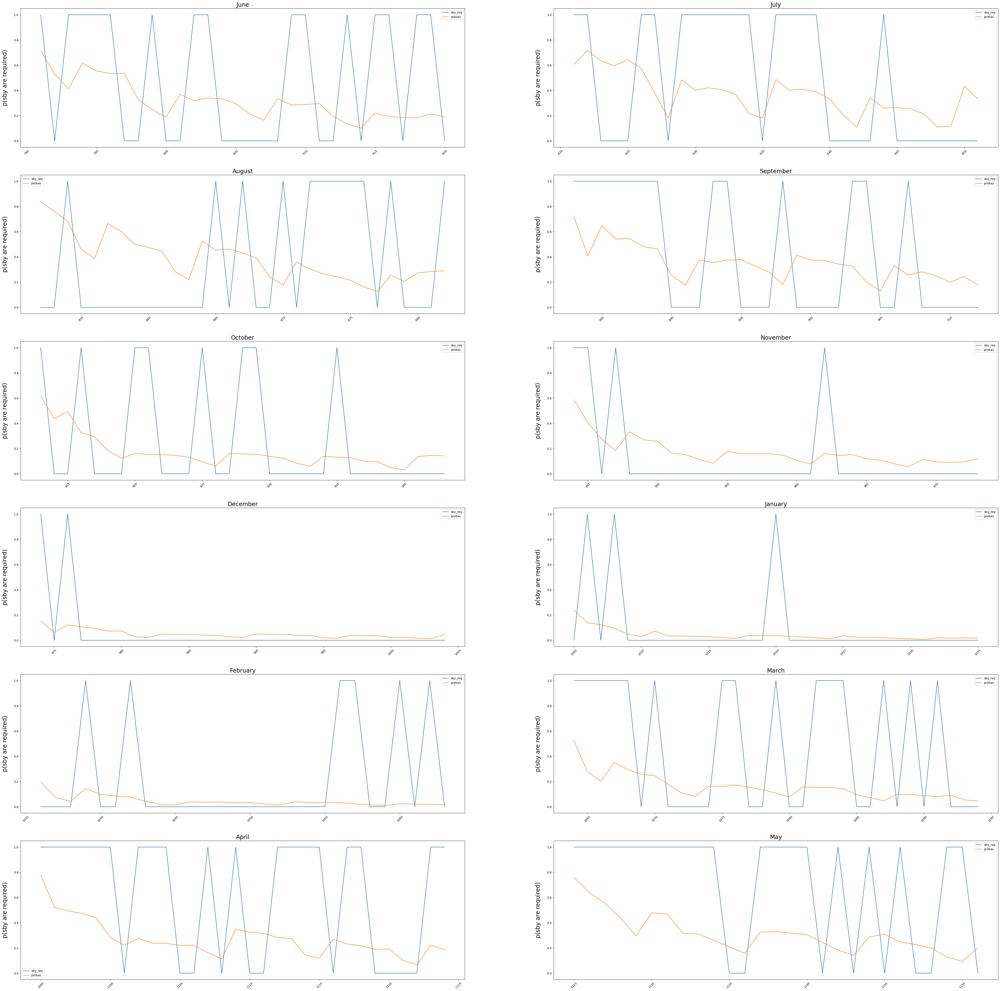

In [30]:
# default classifier

from interpret.glassbox import ExplainableBoostingClassifier


clf_output = cv_ebm_class_one_year(not_encoded_df, year_split, interpretable_scores, 
                                   plotting = True, print_per_month = False, print_mean = True,
                                   oversampler = "None",
                 outer_bags = 8, inner_bags = 8, max_bins = 256, early_stopping_rounds = 50,
                          early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)

In [31]:
clf_probas = clf_output["test_proba_list"].to_list()
from interpret.provider import InlineProvider
from interpret import set_visualize_provider
from interpret import show

set_visualize_provider(InlineProvider())
ebm_clf_global = clf_output.loc[11, "classifiers"].explain_global()
show(ebm_clf_global)


Note: In the feature importances summary in the widget above you can see that there are a lot of interaction terms in the list, while both the features "quarter" and "season" are very high. 
This will be referred to later.
(the widget might be bugged at the moment)


In the following some thresholds will be tested to observe how the most important metrics for my use case change.
Not ALL thresholds will be tested, but only the ones that lead to considerably good performing models when combined with a regressor.

In [126]:

for threshold in [0.05, 0.1, 0.15, 0.2, 0.25, 0.3]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    cv_ebm_class_one_year(not_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                   plotting = False, print_per_month = False, print_mean = True,
                                   oversampler = "None",
                 outer_bags = 8, inner_bags = 8, max_bins = 256, early_stopping_rounds = 50,
                          early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.05


mean train_TPR: 0.9987501404336592
mean train_TNR: 0.21685444172398227
mean train_prec: 0.2860549170482201

mean test_TPR: 0.911111111111111
mean test_TNR: 0.22400680747288693
mean test_prec: 0.4183401408188209


threshold: 0.1


mean train_TPR: 0.9854753240181461
mean train_TNR: 0.35741222477262236
mean train_prec: 0.3251689216722772

mean test_TPR: 0.843530701754386
mean test_TNR: 0.3396351508935842
mean test_prec: 0.47744691114892684


threshold: 0.15


mean train_TPR: 0.9497480362603558
mean train_TNR: 0.503592671921751
mean train_prec: 0.37617277578252173

mean test_TPR: 0.7199561403508773
mean test_TNR: 0.47359184577854657
mean test_prec: 0.47269362342638205


threshold: 0.2


mean train_TPR: 0.8681998221223947
mean train_TNR: 0.6163921991514216
mean train_prec: 0.41595372836204875

mean test_TPR: 0.5269031407189303
mean test_TNR: 0.6204036958352815
mean test_prec: 0.4180372405372405


threshold: 0.25


mean train_TPR: 0.7884989586360348
mean train_TNR: 0.7089

Given these first insights, it appears that the EBM is not overfitting as the training and test metrics are similar.
That said, there is a quite big difference between train and test TPRs when the threshold exceeds 0.1.
the performance overall just isn't that awesome...

"    To produce the best models, we generally recommend setting outer_bags and inner_bags to 25 or more each. This will significantly slow down the training time of the algorithm, and may be infeasible on larger datasets, but tends to produce smoother graphs with marginally higher accuracy." - interpretML documentation

now, test with 30 bags 

In [127]:
#30 bags 

for threshold in [0.05, 0.1, 0.15, 0.2, 0.25, 0.3]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    cv_ebm_class_one_year(not_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                   plotting = False, print_per_month = False, print_mean = True,
                                   oversampler = "None",
                 outer_bags = 30, inner_bags = 30, max_bins = 256, early_stopping_rounds = 50,
                          early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.05


mean train_TPR: 0.9984113870461253
mean train_TNR: 0.22549776844381955
mean train_prec: 0.2883117271092444

mean test_TPR: 0.911111111111111
mean test_TNR: 0.2286323902234697
mean test_prec: 0.41619181022221435


threshold: 0.1


mean train_TPR: 0.9863060352534462
mean train_TNR: 0.3706539269223437
mean train_prec: 0.32984251118195096

mean test_TPR: 0.8379751461988304
mean test_TNR: 0.37272190370016456
mean test_prec: 0.49989454498372893


threshold: 0.15


mean train_TPR: 0.9482921116198528
mean train_TNR: 0.5147174839377727
mean train_prec: 0.38070459610203944

mean test_TPR: 0.6410719032429559
mean test_TNR: 0.5052424868041875
mean test_prec: 0.432041523776906


threshold: 0.2


mean train_TPR: 0.8690833783741162
mean train_TNR: 0.6198446307996209
mean train_prec: 0.418211358815521

mean test_TPR: 0.5213475851633746
mean test_TNR: 0.6113666340408667
mean test_prec: 0.41427322677322675


threshold: 0.25


mean train_TPR: 0.7942494005246424
mean train_TNR: 0.71183

Using 30 bags has improved the model when the threshold was 0.1 and 0.15! 

That said, the overall precision appeared to be kind of low which could also be testament of the decision thresholds that are chosen to have high TPRs in accordance with the business goals.

"    Conversely, for underfit models which appear too conservative, you can do the opposite of the previous suggestions – increase max_bins and make early stopping less aggressive. It might also be helpful to increase the total allowed max_rounds."

Let's try that anyway.

The thresholds > 0.2 will be omitted as they have yielded very low TPRs above

In [132]:
#30 bags, max_bins increasing; early stopping rounds from 50 raised to 100

for threshold in [0.05, 0.1, 0.15, 0.2]:
    
    print(f"\n\nthreshold: {threshold}")
    
    for max_bin in [256, 512, 1024]:
        
        print(f"\nmax_bin {max_bin}")
    
        cv_ebm_class_one_year(not_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                       plotting = False, print_per_month = False, print_mean = True,
                                       oversampler = "None",
                     outer_bags = 30, inner_bags = 30, max_bins = max_bin, max_interaction_bins = 32,
                              early_stopping_rounds = 100,
                              early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.05

max_bin 256

mean train_TPR: 0.9984113870461253
mean train_TNR: 0.22549776844381955
mean train_prec: 0.2883117271092444

mean test_TPR: 0.911111111111111
mean test_TNR: 0.2286323902234697
mean test_prec: 0.41619181022221435

max_bin 512

mean train_TPR: 0.9984113870461253
mean train_TNR: 0.22549776844381955
mean train_prec: 0.2883117271092444

mean test_TPR: 0.911111111111111
mean test_TNR: 0.2286323902234697
mean test_prec: 0.41619181022221435

max_bin 1024

mean train_TPR: 0.9984113870461253
mean train_TNR: 0.22549776844381955
mean train_prec: 0.2883117271092444

mean test_TPR: 0.911111111111111
mean test_TNR: 0.2286323902234697
mean test_prec: 0.41619181022221435


threshold: 0.1

max_bin 256

mean train_TPR: 0.9863060352534462
mean train_TNR: 0.3706539269223437
mean train_prec: 0.32984251118195096

mean test_TPR: 0.8379751461988304
mean test_TNR: 0.37272190370016456
mean test_prec: 0.49989454498372893

max_bin 512

mean train_TPR: 0.9863060352534462
mean train_TN

Increasing max_bin and the early stopping rounds had virtually no effect on the performance.

"    If many of the included interaction terms are significant (e.g. learning large values or ranking highly on the overall importance list), there’s a chance the 10 interaction terms included by default is insufficient for your dataset. Consider increasing this number."

Let's try 20 as there were quite a lot of interaction effects in the feature importances plot of the above widget.

        

In [134]:
#30 bags, 20 interactions

for threshold in [0.05, 0.1, 0.15, 0.2]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    cv_ebm_class_one_year(not_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                       plotting = False, print_per_month = False, print_mean = True,
                                       oversampler = "None",
                     outer_bags = 30, inner_bags = 30, max_bins = 256, max_interaction_bins = 32,
                              early_stopping_rounds = 50,
                              early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 20,)



threshold: 0.05


mean train_TPR: 0.9981094546789756
mean train_TNR: 0.22671103933845047
mean train_prec: 0.2885752475078481

mean test_TPR: 0.911111111111111
mean test_TNR: 0.2286323902234697
mean test_prec: 0.41619181022221435


threshold: 0.1


mean train_TPR: 0.9858456300969084
mean train_TNR: 0.36512818488205007
mean train_prec: 0.3278174095453847

mean test_TPR: 0.8379751461988304
mean test_TNR: 0.36909871529436744
mean test_prec: 0.4988377816987048


threshold: 0.15


mean train_TPR: 0.9468689159889726
mean train_TNR: 0.5097332256162538
mean train_prec: 0.37803093275593946

mean test_TPR: 0.6410719032429559
mean test_TNR: 0.48841556372726447
mean test_prec: 0.42442459360562806


threshold: 0.2


mean train_TPR: 0.8690751421593889
mean train_TNR: 0.6173765676641132
mean train_prec: 0.41668238563538096

mean test_TPR: 0.5312891056312109
mean test_TNR: 0.597928948360534
mean test_prec: 0.41176920301920306


Increasing the number of interactions lead to marginally worse test performance in some thresholds. 
Therefore, I will stick to the default 10.

"For general tuning, we recommend sweeping max_bins with values between 32 and 1024, and max_leaves from 2 to 5. These improvements are normally marginal, but may help significantly on some datasets."

It was already attempted before to sweep max_bins, but maybe there are interactions with max_leaves, so let's try again.

The decision thresholds 0.1 and 0.15 were always the best performing ones when combined with a regressor. 
Given that I am trying many different parameter combinations, I will stick to those for the time being to get a rough feeling for which parameter combinations might be worthwile pursuing further.


In [139]:
#30 bags, max_bins and max_leaves changing. 


for threshold in [0.1, 0.15]:
    
    print(f"\n\nthreshold: {threshold}")
    
    for max_bins in [32, 256, 512, 1024]: #256 is default
        
        print(f"\nmax_bin {max_bins}")
        
        for max_leaves in [2, 3, 5]: # 3 is default
            
            print(f"\nmax_leaves {max_leaves}")
    
            cv_ebm_class_one_year(not_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                       plotting = False, print_per_month = False, print_mean = True,
                                       oversampler = "None",
                     outer_bags = 30, inner_bags = 30, max_bins = max_bins, max_interaction_bins = 32,
                              early_stopping_rounds = 50,
                              early_stopping_tolerance = 0.0001, max_leaves = max_leaves, interactions = 10,)



threshold: 0.1

max_bin 32

max_leaves 2

mean train_TPR: 0.9849789745398562
mean train_TNR: 0.3666949554551726
mean train_prec: 0.32816512376545454

mean test_TPR: 0.842361111111111
mean test_TNR: 0.37184492741557956
mean test_prec: 0.49164204012585744

max_leaves 3

mean train_TPR: 0.9863060352534462
mean train_TNR: 0.3706539269223437
mean train_prec: 0.32984251118195096

mean test_TPR: 0.8379751461988304
mean test_TNR: 0.37272190370016456
mean test_prec: 0.49989454498372893

max_leaves 5

mean train_TPR: 0.98664478864098
mean train_TNR: 0.3693778599721942
mean train_prec: 0.32946661350700085

mean test_TPR: 0.843530701754386
mean test_TNR: 0.3747251088283697
mean test_prec: 0.5021907477963724

max_bin 256

max_leaves 2

mean train_TPR: 0.9849789745398562
mean train_TNR: 0.3666949554551726
mean train_prec: 0.32816512376545454

mean test_TPR: 0.842361111111111
mean test_TNR: 0.37184492741557956
mean test_prec: 0.49164204012585744

max_leaves 3

mean train_TPR: 0.9863060352534462
mea

Increasing max_leaves to 5 is beneficial for threshold 0.1, but 3 is best for 0.15.
Model performance only changes marginally however.

Again, changing max_bin size has no impact on performance.

## Oversampling

Next, as the dataset is rather unbalanced between the classes, it was tested whether oversampling the minority class would improve performance.

For that matter, the SMOTE algorithm was was used. A nice visual explaination of how the technique work can be found here https://imbalanced-learn.org/stable/over_sampling.html.

(I am not trying ADASYN here as it does not work for categorical features.
SMOTENC is for mixture of numerical and categorical features; SMOTEN is for purely categorical.
The features in not_encoded_df are purely categorical; day_of_the_month is not continuous.)

to get a quick impression of how performance changes when oversampling is considered, default EBM settings were used first as these are the fastest.

In [148]:
#the oversampler requires numerical categories


num_encoded_df = data[["ds", "y", "sby_required", 
                       "weekday", "day_of_month", 
                       "month", "is_weekend", "kids_out_of_school", 
                      "quarter", "season", "week_num"]]


num_encoded_df.season.replace({"spring" : 1, "summer": 2, "fall": 3, "winter": 4}, inplace = True)

num_encoded_df

/tmp/ipykernel_12632/3404839542.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,ds,y,sby_required,weekday,day_of_month,month,is_weekend,kids_out_of_school,quarter,season,week_num
0,2016-04-01,4.0,True,4,1,4,False,True,2,1,1
1,2016-04-02,70.0,True,5,2,4,True,False,2,1,1
2,2016-04-03,0.0,False,6,3,4,True,False,2,1,1
3,2016-04-04,0.0,False,0,4,4,False,False,2,1,1
4,2016-04-05,0.0,False,1,5,4,False,False,2,1,1
...,...,...,...,...,...,...,...,...,...,...,...
1147,2019-05-23,0.0,False,3,23,5,False,False,2,1,4
1148,2019-05-24,0.0,False,4,24,5,False,False,2,1,4
1149,2019-05-25,146.0,True,5,25,5,True,False,2,1,4
1150,2019-05-26,160.0,True,6,26,5,True,False,2,1,4


In [149]:
for threshold in [0.1, 0.15, 0.2,]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for sampler in ["None", "smoten"]:
        
        print(f"\nsampler: {sampler}\n")
    
        cv_ebm_class_one_year(num_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                   plotting = False, print_per_month = False, print_mean = True,
                                   oversampler = sampler,
                 outer_bags = 8, inner_bags = 8, max_bins = 256, early_stopping_rounds = 50,
                          early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.1


sampler: None


mean train_TPR: 0.9852503741241017
mean train_TNR: 0.37410262549967827
mean train_prec: 0.3308884695755716

mean test_TPR: 0.8379751461988304
mean test_TNR: 0.34577504059325653
mean test_prec: 0.4656360702918971

sampler: smoten


mean train_TPR: 0.9923121943571857
mean train_TNR: 0.4837789594839446
mean train_prec: 0.657885184064585

mean test_TPR: 0.7463716108452951
mean test_TNR: 0.4970120974409271
mean test_prec: 0.5535877452687797


threshold: 0.15


sampler: None


mean train_TPR: 0.9487376337850258
mean train_TNR: 0.5171120754279376
mean train_prec: 0.3819663126601147

mean test_TPR: 0.6977339181286549
mean test_TNR: 0.49161044535884685
mean test_prec: 0.5520039682539682

sampler: smoten


mean train_TPR: 0.9865472517897463
mean train_TNR: 0.5496114300631189
mean train_prec: 0.6866797296496578

mean test_TPR: 0.7036084529505583
mean test_TNR: 0.5451647085411085
mean test_prec: 0.5645390045361934


threshold: 0.2


sampler: None


mean train_TPR

SMOTE substantially improves precision across all thresholds.

However, it appears that SMOTE may lead to overfitting as there is high discrepancy between train and test TPRs and precisions.

Therefore the following should be tested:

"    If you believe the models might be overfitting (ex: large difference between train and test error, or high degrees of instability in graphs), consider the following options:

        Reduce max_bins for smaller datasets, to clump more data together.

        Make the early stopping more aggressive by decreasing early_stopping_rounds and increasing early_stopping_tolerance.
"
https://interpret.ml/docs/faq.html



In [150]:
for threshold in [0.1, 0.15, 0.2,]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for max_bin in [32, 128, 256]:
        
        print(f"\nmax_bin: {max_bin}\n")
    
        cv_ebm_class_one_year(num_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                   plotting = False, print_per_month = False, print_mean = True,
                                   oversampler = "smoten",
                 outer_bags = 8, inner_bags = 8, max_bins = max_bin, early_stopping_rounds = 50,
                          early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.1


max_bin: 32


mean train_TPR: 0.9925433343575955
mean train_TNR: 0.4840762762151962
mean train_prec: 0.6580684652035241

mean test_TPR: 0.7463716108452951
mean test_TNR: 0.49413853422253634
mean test_prec: 0.5396988563798909

max_bin: 128


mean train_TPR: 0.9923121943571857
mean train_TNR: 0.4837789594839446
mean train_prec: 0.657885184064585

mean test_TPR: 0.7463716108452951
mean test_TNR: 0.4970120974409271
mean test_prec: 0.5535877452687797

max_bin: 256


mean train_TPR: 0.9923121943571857
mean train_TNR: 0.4837789594839446
mean train_prec: 0.657885184064585

mean test_TPR: 0.7463716108452951
mean test_TNR: 0.4970120974409271
mean test_prec: 0.5535877452687797


threshold: 0.15


max_bin: 32


mean train_TPR: 0.9865472517897463
mean train_TNR: 0.5506088831220907
mean train_prec: 0.6871532709822122

mean test_TPR: 0.7036084529505583
mean test_TNR: 0.5447466483404397
mean test_prec: 0.5664239251711141

max_bin: 128


mean train_TPR: 0.9865472517897463
mean train_

changing the max_bins param does not really have an impact on performance.

maybe tweak early stopping rounds and tolerance?

In [152]:
for threshold in [ 0.15,]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for rounds in [10, 25]:
        
        print(f"\nrounds: {rounds}\n")
        
        for tolerance in [0.0005, 0.001]:
            
            print(f"\ntolerance: {tolerance}\n")
    
            cv_ebm_class_one_year(num_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                       plotting = False, print_per_month = False, print_mean = True,
                                       oversampler = "smoten",
                     outer_bags = 8, inner_bags = 8, max_bins = 256, early_stopping_rounds = rounds,
                              early_stopping_tolerance = tolerance, max_leaves = 3, interactions = 10,)



threshold: 0.15


rounds: 10


tolerance: 0.0005


mean train_TPR: 0.9869863725604824
mean train_TNR: 0.5421938176435724
mean train_prec: 0.683274016059

mean test_TPR: 0.693666932482722
mean test_TNR: 0.5311248534686449
mean test_prec: 0.5572473378695267

tolerance: 0.001


mean train_TPR: 0.9868787442059775
mean train_TNR: 0.5337468084857614
mean train_prec: 0.6792521155341035

mean test_TPR: 0.7145002658160554
mean test_TNR: 0.5295397085411085
mean test_prec: 0.563298925171114

rounds: 25


tolerance: 0.0005


mean train_TPR: 0.9869863725604824
mean train_TNR: 0.5421938176435724
mean train_prec: 0.683274016059

mean test_TPR: 0.693666932482722
mean test_TNR: 0.5311248534686449
mean test_prec: 0.5572473378695267

tolerance: 0.001


mean train_TPR: 0.9868787442059775
mean train_TNR: 0.5337468084857614
mean train_prec: 0.6792521155341035

mean test_TPR: 0.7145002658160554
mean test_TNR: 0.5295397085411085
mean test_prec: 0.563298925171114


max_rounds may not be important for the values checked.
Increasing the tolerance lead to improvements however.



In [153]:
for threshold in [ 0.15,]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for rounds in [50]: #default
        
        print(f"\nrounds: {rounds}\n")
        
        for tolerance in [0.0001, 0.001, 0.005, 0.01]: #0.0001 is default
            
            print(f"\ntolerance: {tolerance}\n")
    
            cv_ebm_class_one_year(num_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                       plotting = False, print_per_month = False, print_mean = True,
                                       oversampler = "smoten",
                     outer_bags = 8, inner_bags = 8, max_bins = 256, early_stopping_rounds = rounds,
                              early_stopping_tolerance = tolerance, max_leaves = 3, interactions = 10,)



threshold: 0.15


rounds: 50


tolerance: 0.0001


mean train_TPR: 0.9865472517897463
mean train_TNR: 0.5496114300631189
mean train_prec: 0.6866797296496578

mean test_TPR: 0.7036084529505583
mean test_TNR: 0.5451647085411085
mean test_prec: 0.5645390045361934

tolerance: 0.001


mean train_TPR: 0.9868787442059775
mean train_TNR: 0.5337468084857614
mean train_prec: 0.6792521155341035

mean test_TPR: 0.7145002658160554
mean test_TNR: 0.5295397085411085
mean test_prec: 0.563298925171114

tolerance: 0.005


mean train_TPR: 0.9890540440605915
mean train_TNR: 0.5046501061991703
mean train_prec: 0.6664023670408258

mean test_TPR: 0.7424607921318448
mean test_TNR: 0.5053725562489563
mean test_prec: 0.5445022136298372

tolerance: 0.01


mean train_TPR: 0.9907022293052922
mean train_TNR: 0.48366786023295455
mean train_prec: 0.6575117343045961

mean test_TPR: 0.7544225146198831
mean test_TNR: 0.4948206081970082
mean test_prec: 0.5030612674362674


Increasing the tolerance did not lead to the desired results. I will stick to the default here.

Does increasing the bag sizes lead to better models again?

In [156]:

for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8, 30, 50]:
    
        print(f"\nbag_size: {bag_size}\n")
    
        cv_ebm_class_one_year(num_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                       plotting = False, print_per_month = False, print_mean = True,
                                       oversampler = "smoten",
                     outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                              early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.15


bag_size: 8


mean train_TPR: 0.9865472517897463
mean train_TNR: 0.5496114300631189
mean train_prec: 0.6866797296496578

mean test_TPR: 0.7036084529505583
mean test_TNR: 0.5451647085411085
mean test_prec: 0.5645390045361934

bag_size: 30


mean train_TPR: 0.9870326067977495
mean train_TNR: 0.5678648738158186
mean train_prec: 0.6956572621641576

mean test_TPR: 0.6603335991493886
mean test_TNR: 0.5480226145240146
mean test_prec: 0.4843170676566479

bag_size: 50


mean train_TPR: 0.9876909766352067
mean train_TNR: 0.5724267422857633
mean train_prec: 0.697986903800114

mean test_TPR: 0.6881113769271664
mean test_TNR: 0.5552689913356088
mean test_prec: 0.5727786061181863


Oddly, increasing the bag size to 30 has lead to a worse performing model.
However, this could also be an artifact of the decision threshold chosen as it might have gotten too low given that we have improved the model, thereby leading to more false positives.

I'll check for higher thresholds.

(Interestingly, however, the drop in precision was rescued by increasing the bag size to 50.
Nevertheless, the peformance did only increase by about 1 % there when compared to baseline.)

In [157]:

for threshold in [0.2, 0.25]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8, 30]:
    
        print(f"\nbag_size: {bag_size}")
    
        cv_ebm_class_one_year(num_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                       plotting = False, print_per_month = False, print_mean = True,
                                       oversampler = "smoten",
                     outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                              early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.2


bag_size: 8

mean train_TPR: 0.9789772983585917
mean train_TNR: 0.6064684491802083
mean train_prec: 0.7133784049125276

mean test_TPR: 0.6404505582137161
mean test_TNR: 0.6027631576197366
mean test_prec: 0.5029130064217783

bag_size: 30

mean train_TPR: 0.9800631657881972
mean train_TNR: 0.6213881413505278
mean train_prec: 0.721481406391871

mean test_TPR: 0.6085061137692717
mean test_TNR: 0.6223585682477559
mean test_prec: 0.5004847382326406


threshold: 0.25


bag_size: 8

mean train_TPR: 0.9704416510038145
mean train_TNR: 0.6541028785812458
mean train_prec: 0.7373104477702205

mean test_TPR: 0.5714206845785793
mean test_TNR: 0.6311900899868864
mean test_prec: 0.49904574799076085

bag_size: 30

mean train_TPR: 0.9717430077013555
mean train_TNR: 0.670242972651023
mean train_prec: 0.7467773464048871

mean test_TPR: 0.57580664949086
mean test_TNR: 0.6546049450593502
mean test_prec: 0.5131664903723728


In [158]:
for threshold in [0.2, 0.25]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [50]:
    
        print(f"\nbag_size: {bag_size}")
    
        cv_ebm_class_one_year(num_encoded_df, year_split, interpretable_scores, decision_thr = threshold,
                                       plotting = False, print_per_month = False, print_mean = True,
                                       oversampler = "smoten",
                     outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                              early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.2


bag_size: 50

mean train_TPR: 0.980124713513864
mean train_TNR: 0.624791632612579
mean train_prec: 0.7232540513675346

mean test_TPR: 0.5997341839447102
mean test_TNR: 0.6168030126922004
mean test_prec: 0.4952062233179028


threshold: 0.25


bag_size: 50

mean train_TPR: 0.9717805942922241
mean train_TNR: 0.6720785867068951
mean train_prec: 0.7477856774038774

mean test_TPR: 0.564695538379749
mean test_TNR: 0.6546049450593502
mean test_prec: 0.5099301798992202


Increasing the bag size to 50 did not further increase the performance in the 0.2 threshold. 
Training the thing took 15 min though, so I will stick to lower bag sizes than that.


### Feature elimination

Does the model perform better if features are eliminated?

The is_weekend feature is basically just "saturday" and "sunday" of the weekday feature,
and season is very close to quarter, so natrually there will be high correlation among those features. 
Maybe excluding them could be worthwile.

Scikit learn's recursive feature elimination would iteratively eliminate the features with the lowest importances until a predetermined number of features remains.
https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.RFE.html#sklearn.feature_selection.RFE
The problem here is that "quarter" and "season" are the two most imporant features in the EBM, so both will be kept in most likely.
Statistical procedures will also not help with this problem as the FDR approach would not selectively eliminate one of the most significant features either.
Therefore, I will have to exclude those features manually and check for changes in performance subsequently.

To test whether more of the less important features from our model (e.g. interaction terms) should be eliminated, different values for the interaction parameter can be tested as the interaction parameter specifies the max number of interactions allowed in the model. 

In [162]:

for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8]:
    
        print(f"\nbag_size: {bag_size}\n")
        
        for feature_to_drop in ["season", "quarter", "is_weekend", "kids_out_of_school"]:
            
            print(f"\nexcluded feature: {feature_to_drop}\n")
            
            dropped_df = num_encoded_df.drop(columns = feature_to_drop)
    
            cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = threshold,
                                           plotting = False, print_per_month = False, print_mean = True,
                                           oversampler = "smoten",
                         outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                                  early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.15


bag_size: 8


excluded feature: season


mean train_TPR: 0.9863824045366122
mean train_TNR: 0.5480042683398837
mean train_prec: 0.6859057600923698

mean test_TPR: 0.6806917862838916
mean test_TNR: 0.5564699128210571
mean test_prec: 0.5204681901835163

excluded feature: quarter


mean train_TPR: 0.9872511018181113
mean train_TNR: 0.5413150414263347
mean train_prec: 0.682852415596976

mean test_TPR: 0.7212254120148858
mean test_TNR: 0.5395383150071064
mean test_prec: 0.5698465442187332

excluded feature: is_weekend


mean train_TPR: 0.9877196165145348
mean train_TNR: 0.5506436963434261
mean train_prec: 0.6874977437500044

mean test_TPR: 0.6400344538502433
mean test_TNR: 0.5382655539517366
mean test_prec: 0.5165748490672425

excluded feature: kids_out_of_school


mean train_TPR: 0.9870288149961374
mean train_TNR: 0.5544478085476302
mean train_prec: 0.6892151160244696

mean test_TPR: 0.6427166400850611
mean test_TNR: 0.5596772038959952
mean test_prec: 0.4521584997128475

Interestingly, excluding is_weekend degrades performance. 

Further, I am happy to see that keeping kids_out_of_school in the model prevents a drop by nearly 10 % in precision in the test set. So, researching all those school holidays etc. has been a worthwile time investment after all!

Reagarding season and quarter, it appears that season is the feature that is more beneficial to us.

..but do we even need either one?

In [163]:

for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8]:
    
        print(f"\nbag_size: {bag_size}\n")
        
        for feature_to_drop in [["season", "quarter"]]:
            
            print(f"\nexcluded feature: {feature_to_drop}\n")
            
            dropped_df = num_encoded_df.drop(columns = feature_to_drop)
    
            cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = threshold,
                                           plotting = False, print_per_month = False, print_mean = True,
                                           oversampler = "smoten",
                         outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                                  early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = 10,)



threshold: 0.15


bag_size: 8


excluded feature: ['season', 'quarter']


mean train_TPR: 0.9880495495780693
mean train_TNR: 0.5360115841508227
mean train_prec: 0.6805913084991441

mean test_TPR: 0.6978335991493886
mean test_TNR: 0.5131382028545578
mean test_prec: 0.5029438588300817


Yes, keeping season in prevents a drop by a few percentages.

Now, let's see whether changing the number of interaction terms has an impact on performance.




In [165]:

for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8]:
    
        print(f"\nbag_size: {bag_size}\n")
        
        for feature_to_drop in ["quarter"]:
            
            print(f"\nexcluded feature: {feature_to_drop}\n")
            
            dropped_df = num_encoded_df.drop(columns = feature_to_drop)
            
            for interaction_terms in [0, 3, 6, 10, 15]:
                
                print(f"\ninteraction_terms: {interaction_terms}\n")
            
                cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = threshold,
                                               plotting = False, print_per_month = False, print_mean = True,
                                               oversampler = "smoten",
                             outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                                      early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = interaction_terms,)



threshold: 0.15


bag_size: 8


excluded feature: quarter


interaction_terms: 0


mean train_TPR: 0.9920714144327151
mean train_TNR: 0.42097538901556925
mean train_prec: 0.631670548971966

mean test_TPR: 0.7597587719298247
mean test_TNR: 0.45245815742938505
mean test_prec: 0.4952471063411215

interaction_terms: 3


mean train_TPR: 0.987556817998453
mean train_TNR: 0.4905182117351179
mean train_prec: 0.6599274314815861

mean test_TPR: 0.6906333067517277
mean test_TNR: 0.5250240124680662
mean test_prec: 0.5060007654592715

interaction_terms: 6


mean train_TPR: 0.9863214121108518
mean train_TNR: 0.5329857251771022
mean train_prec: 0.6788407092110993

mean test_TPR: 0.6948365231259969
mean test_TNR: 0.5444402757914201
mean test_prec: 0.5622652211564122

interaction_terms: 10


mean train_TPR: 0.9872511018181113
mean train_TNR: 0.5413150414263347
mean train_prec: 0.682852415596976

mean test_TPR: 0.7212254120148858
mean test_TNR: 0.5395383150071064
mean test_prec: 0.5698465442187332

in

Having more interaction terms lead to better performance.

More than 15 desired?

In [166]:

for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8]:
    
        print(f"\nbag_size: {bag_size}\n")
        
        for feature_to_drop in ["quarter"]:
            
            print(f"\nexcluded feature: {feature_to_drop}\n")
            
            dropped_df = num_encoded_df.drop(columns = feature_to_drop)
            
            for interaction_terms in [20]:
                
                print(f"\ninteraction_terms: {interaction_terms}\n")
            
                cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = threshold,
                                               plotting = False, print_per_month = False, print_mean = True,
                                               oversampler = "smoten",
                             outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                                      early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = interaction_terms,)



threshold: 0.15


bag_size: 8


excluded feature: quarter


interaction_terms: 20


mean train_TPR: 0.9871504418336663
mean train_TNR: 0.5369510301640581
mean train_prec: 0.68087673225297

mean test_TPR: 0.7101143009037747
mean test_TNR: 0.548623206564824
mean test_prec: 0.558704908077097


In [167]:

for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8]:
    
        print(f"\nbag_size: {bag_size}\n")
        
        for feature_to_drop in ["quarter"]:
            
            print(f"\nexcluded feature: {feature_to_drop}\n")
            
            dropped_df = num_encoded_df.drop(columns = feature_to_drop)
            
            for interaction_terms in [16]:
                
                print(f"\ninteraction_terms: {interaction_terms}\n")
            
                cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = threshold,
                                               plotting = False, print_per_month = False, print_mean = True,
                                               oversampler = "smoten",
                             outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                                      early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = interaction_terms,)



threshold: 0.15


bag_size: 8


excluded feature: quarter


interaction_terms: 16


mean train_TPR: 0.9873881723381057
mean train_TNR: 0.5432252448060683
mean train_prec: 0.6838446206680177

mean test_TPR: 0.7156698564593302
mean test_TNR: 0.5524110853527028
mean test_prec: 0.574329908077097


In [168]:

for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8]:
    
        print(f"\nbag_size: {bag_size}\n")
        
        for feature_to_drop in ["quarter"]:
            
            print(f"\nexcluded feature: {feature_to_drop}\n")
            
            dropped_df = num_encoded_df.drop(columns = feature_to_drop)
            
            for interaction_terms in [17]:
                
                print(f"\ninteraction_terms: {interaction_terms}\n")
            
                cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = threshold,
                                               plotting = False, print_per_month = False, print_mean = True,
                                               oversampler = "smoten",
                             outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                                      early_stopping_tolerance = 0.0001, max_leaves = 3, interactions = interaction_terms,)



threshold: 0.15


bag_size: 8


excluded feature: quarter


interaction_terms: 17


mean train_TPR: 0.9869535568737021
mean train_TNR: 0.5405817039786569
mean train_prec: 0.6824850969462047

mean test_TPR: 0.7212254120148858
mean test_TNR: 0.5472027520193695
mean test_prec: 0.5725937969659859


16 terms appear to be a sweet spot.

what about num_leaves for general tuning?


In [169]:

for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8]:
    
        print(f"\nbag_size: {bag_size}\n")
        
        for feature_to_drop in ["quarter"]:
            
            print(f"\nexcluded feature: {feature_to_drop}\n")
            
            dropped_df = num_encoded_df.drop(columns = feature_to_drop)
            
            for interaction_terms in [16]:
                
                print(f"\ninteraction_terms: {interaction_terms}\n")
                
                for leaves in [2, 3, 5]:
                
                    print(f"\nleaves: {leaves}\n")
            
                    cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = threshold,
                                                   plotting = False, print_per_month = False, print_mean = True,
                                                   oversampler = "smoten",
                                 outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                                          early_stopping_tolerance = 0.0001, max_leaves = leaves, interactions = interaction_terms,)



threshold: 0.15


bag_size: 8


excluded feature: quarter


interaction_terms: 16


leaves: 2


mean train_TPR: 0.9875889954049272
mean train_TNR: 0.5388766161572177
mean train_prec: 0.6818650443366954

mean test_TPR: 0.7101143009037746
mean test_TNR: 0.548186565910792
mean test_prec: 0.5541939973481556

leaves: 3


mean train_TPR: 0.9873881723381057
mean train_TNR: 0.5432252448060683
mean train_prec: 0.6838446206680177

mean test_TPR: 0.7156698564593302
mean test_TNR: 0.5524110853527028
mean test_prec: 0.574329908077097

leaves: 5


mean train_TPR: 0.9875243748867181
mean train_TNR: 0.5458519649078001
mean train_prec: 0.6851067120402606

mean test_TPR: 0.7212254120148858
mean test_TNR: 0.5575425693844426
mean test_prec: 0.5881494113425942


Performance increases from 2 to 5 leaves. Does it increase further if the number of leaves is increased even further?

In [170]:
for threshold in [0.15]:
    
    print(f"\n\nthreshold: {threshold}\n")
    
    for bag_size in [8]:
    
        print(f"\nbag_size: {bag_size}\n")
        
        for feature_to_drop in ["quarter"]:
            
            print(f"\nexcluded feature: {feature_to_drop}\n")
            
            dropped_df = num_encoded_df.drop(columns = feature_to_drop)
            
            for interaction_terms in [16]:
                
                print(f"\ninteraction_terms: {interaction_terms}\n")
                
                for leaves in [8, 10]:
                
                    print(f"\nleaves: {leaves}\n")
            
                    cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = threshold,
                                                   plotting = False, print_per_month = False, print_mean = True,
                                                   oversampler = "smoten",
                                 outer_bags = bag_size, inner_bags = bag_size, max_bins = 256, early_stopping_rounds = 50,
                                          early_stopping_tolerance = 0.0001, max_leaves = leaves, interactions = interaction_terms,)



threshold: 0.15


bag_size: 8


excluded feature: quarter


interaction_terms: 16


leaves: 8


mean train_TPR: 0.986861512119161
mean train_TNR: 0.549439692019616
mean train_prec: 0.6866856808565124

mean test_TPR: 0.6878920786815524
mean test_TNR: 0.5532657862074036
mean test_prec: 0.4993219157497313

leaves: 10


mean train_TPR: 0.9863992994594755
mean train_TNR: 0.5502662646518889
mean train_prec: 0.6869788853733448

mean test_TPR: 0.6835061137692717
mean test_TNR: 0.5532657862074036
mean test_prec: 0.498416118648282


5 leaves is good

### Transition to business metrics

Now, let's see how the optimized EBC performs when combined with a regressor as this will allow us to check the business metrics

In [1]:
def cv_sktime_models_one_year(model, statsforecast_df, splits_dict, custom_scorer, plotting = True,
                     print_per_month = True, print_mean = True, transformer = None, smoothing = None,
                             interval = None):
    """
    function to perform cv for a given model
    
    For some reason, this function always throws the "returning a view versus a copy" warning
    (https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy)
    when rolling windows are calculated or transformers are used.
    I have no clue why they are thrown however, as .loc is used wherever possible.
    the rolling method appears to be correctly implemented as well
    https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.rolling.html
    
    
    """

    from sktime.transformations.series.boxcox import LogTransformer
    from sktime.transformations.series.boxcox import BoxCoxTransformer
    from sktime.forecasting.base import ForecastingHorizon
    
    #init lists to append scores for single months 
    # to calculate average scores for all folds
    efficiency_losses = []
    num_undershoots = []
    magnitude_undershoots = []
    y_pred_list = []
    regressors = []
    
    #plotting
    if plotting == True:
        fig, axes = plt.subplots(6, 2, figsize = (60,60))
        # a counter to get the correct ax object
        i = 0
    
    for split in splits_dict.keys(): 
        
        #extract data from the splits_dict for enhanced readability inside the function
        last_train_day = splits_dict[split]["last_train_day"]
        first_test_day = splits_dict[split]["first_test_day"]
        last_test_day = splits_dict[split]["last_test_day"]
        month = splits_dict[split]["month"]
        leading_days = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds < first_test_day)])
        
        #calculate the length of the forecasting horizon
        horizon = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds <= last_test_day)])  
        
        #extract train and test data
        Y_train_df = statsforecast_df.loc[statsforecast_df.ds <= last_train_day, :]
        Y_test_df = statsforecast_df.loc[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day), :]
        
        #print(Y_train_df)
        
        #smooth the data
        if smoothing == "MA_weekly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 7, center = True, closed = "both", min_periods = 1).mean()
        elif smoothing == "MA_monthly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 31, center = True, closed = "both", min_periods = 1).mean()
        if smoothing == "MA_oneday":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].rolling(window = 3, center = True, closed = "both", min_periods = 1).mean()
        elif smoothing == "EWM_monthly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].ewm(span = 30, min_periods = 1).mean()
        elif smoothing == "EWM_weekly":
            Y_train_df.loc[:, "y"] = Y_train_df.loc[:, "y",].ewm(span = 7, min_periods = 1).mean()
            
        #print(Y_train_df)
        
        #transform train data
        if transformer == "ln":
            trafo_obj = LogTransformer(offset = 1)#
            Y_train_transformed = trafo_obj.fit_transform(Y_train_df.loc[:, "y"])
            Y_train_df.loc[:, "y"] = Y_train_transformed
        elif transformer == "boxcox":
            # no offset param available. 
            trafo_obj = BoxCoxTransformer()
            Y_train_transformed = trafo_obj.fit_transform(Y_train_df.loc[:, "y"] + 1)
            Y_train_df.loc[:, "y"] = Y_train_transformed 
                
        
        #fit and predict
        model_obj = model
        model_obj.fit(Y_train_df.loc[:, 'y'].values)
        regressors.append(model_obj)
        
        if interval != None:
            Y_hat_df = pd.DataFrame({"y": model_obj.predict_interval(np.arange(leading_days, horizon), 
                                                                    coverage  = interval)["Coverage"][interval]["upper"]})
        else:
            Y_hat_df = pd.DataFrame({"y": model_obj.predict(np.arange(leading_days, horizon)).reshape(1,-1)[0]})
            # some models make negative predictions, so those should be set to zero
        Y_hat_df[Y_hat_df["y"] < 0] = 0
                
        #transform back
        if transformer == "ln":
            Y_train_rev_transformed = trafo_obj.inverse_transform(Y_train_df.loc[:, "y"] )
            Y_train_df.loc[:, "y"] = Y_train_rev_transformed
            Y_hat_rev_transformed = trafo_obj.inverse_transform(Y_hat_df.loc[:, "y"])
            Y_hat_df.loc[:, "y"] = Y_hat_rev_transformed
            
        elif transformer == "boxcox":
            # as there is no offset available when initializing the 
            # transformer object, you have to manually subtract 1
            Y_train_rev_transformed = trafo_obj.inverse_transform(Y_train_df.loc[:, "y"] ) - 1
            Y_train_df.loc[:, "y"] = Y_train_rev_transformed
            Y_hat_rev_transformed = trafo_obj.inverse_transform(Y_hat_df.loc[:, "y"]) - 1
            Y_hat_df.loc[:, "y"] = Y_hat_rev_transformed
        
        #get arrays of the data for metrics        
        y_trues = Y_test_df.loc[:, 'y'].values
        y_preds = Y_hat_df.loc[:, 'y'].values
        
        #calculate metrics
        efficiency_loss, num_undershoots_loss, magnitude_undershoots_loss = custom_scorer(y_trues, y_preds)
        efficiency_losses.append(efficiency_loss)
        num_undershoots.append(num_undershoots_loss)
        magnitude_undershoots.append(magnitude_undershoots_loss)
        y_pred_list.append(y_preds)

        if plotting == True:
        # plotting
            ax = axes.flat[i]
    
            ax.plot(Y_test_df.ds, y_trues, label = "y")
            ax.plot(Y_test_df.ds, y_preds, label = "y_hat")
            ax.set_title(month, size = 20)    
            ax.set_ylabel("Number of standby drivers", size = 20, labelpad = 20)
            ax.tick_params(axis = "x", rotation = 45)  
            ax.axhline(y = 90, xmin = 0, xmax = 1, color = "red",
                label = "current policy: 90 drivers")
            ax.legend()
    
            # iterate the counter for the ax object
            i += 1
        
        if print_per_month == True:                
            print(f"\nSplit for {month}")
            print(f"Forecasting for {str(horizon - leading_days)} days")
            print(f"Number of leading days: {leading_days}")
            print(f"Loss in efficiency = {efficiency_loss}")
            print(f"Number of additional underpredictions = {num_undershoots_loss}")
            print(f"Number of additional sby drivers required = {magnitude_undershoots_loss}")
    
    if print_mean == True:
        print("\n")
        print(f"Mean efficiency loss per month in percent = {np.mean(efficiency_losses)}")
        print(f"Mean number of additional underpredictions = {np.mean(num_undershoots)}")
        print(f"Mean number of additional sby drivers required = {np.mean(magnitude_undershoots)}")
    
    
    #https://datagy.io/pandas-dataframe-from-list/
    zipped = list(zip(regressors, 
                      y_pred_list,
                     efficiency_losses,
                     num_undershoots,
                     magnitude_undershoots))

    output_df = pd.DataFrame(zipped, columns = ["regressors",
                                                "y_pred_list",
                                                "efficiency_losses",
                                                "num_undershoots",
                                                "magnitude_undershoots"])
    
    return output_df


        

In [182]:
def combine_clf_reg(statsforecast_df, clf_probas, reg_preds, splits_dict, custom_scorer, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.2, plot_historical = True):
    """
    function to perform cv for a given statsforecast model
    
    
    """

    #init lists to append scores for single months 
    # to calculate average scores for all folds
    efficiency_losses = []
    num_undershoots = []
    magnitude_undershoots = []
    y_trues_list = []
    y_preds_list = []
    y_uncorr_preds_list = []
    X_tests = []
    y_tests = []
    dates_list = []
    feature_names_list = []
    test_dfs = []

    
    #plotting
    if plotting == True:
        fig, axes = plt.subplots(6, 2, figsize = (60,60))
    
    # a counter to get the correct ax object and month
    i = 0
    
    for split in splits_dict.keys(): 
        
        #print(split)
        
        #extract data from the splits_dict for enhanced readability inside the function
        last_train_day = splits_dict[split]["last_train_day"]
        first_test_day = splits_dict[split]["first_test_day"]
        last_test_day = splits_dict[split]["last_test_day"]
        month = splits_dict[split]["month"]
        
        #extract train and test data
        X_test_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)].drop(columns = ["ds", "sby_required", 
                                                                                            "y",])
        Y_test_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)]["y"]
        
        dates = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)]["ds"]
        
        test_df = statsforecast_df[(statsforecast_df.ds >= first_test_day) & 
                                    (statsforecast_df.ds <= last_test_day)]

        
        X_tests.append(X_test_df.values)
        feature_names_list.append(X_test_df.columns.values)
        y_tests.append(Y_test_df.values)
        dates_list.append(dates.values)
        
        
        #calculate the length of the forecasting horizon
        horizon = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds <= last_test_day)])  
        
        #for the preds, you have to get rid of the timepoints 
        #from the last_train_day to the first_test_day, i.e.,
        #the leading period = approximately 15 days, depending on the month
        leading_days = len(statsforecast_df[(statsforecast_df.ds > last_train_day) &
                                      (statsforecast_df.ds < first_test_day)])
        
        
        probas = clf_probas[i]
        probas_bin = (probas >= decision_thr)
        y_hat = reg_preds[i]   
        y_hat_x_probas_bin = y_hat * probas_bin

        y_trues = Y_test_df.values.astype("float64") #manual typing required, otherwise bug in metrics calculations
       
        y_trues_list.append(y_trues)
        y_preds_list.append(y_hat_x_probas_bin)
        y_uncorr_preds_list.append(y_hat)
        
        # insert the probas and preds into test_df for output for later error explainability
        test_df["probas"] = probas
        test_df["y_preds"] = y_hat_x_probas_bin
        test_df["y_trues"] = y_trues # will be float64, thereby wrong types will not create issues later
        test_df["y_preds_uncorr"] = y_hat
        test_dfs.append(test_df)
        
        #calculate metrics
        efficiency_loss, num_undershoots_loss, magnitude_undershoots_loss = custom_scorer(y_trues, y_hat_x_probas_bin)
        efficiency_losses.append(efficiency_loss)
        num_undershoots.append(num_undershoots_loss)
        magnitude_undershoots.append(magnitude_undershoots_loss)
        
        if plotting == True:
        # plotting
            ax = axes.flat[i]    
            ax.plot(dates, y_trues, label = "y", linewidth = "5")
            ax.plot(dates, y_hat_x_probas_bin, label = "y_hat_x_probas_bin", linewidth = "5")
            ax.set_title(month, size = 30)    
            ax.set_ylabel("Number of standby drivers", size = 20, labelpad = 20)
            ax.tick_params(axis = "x", rotation = 45)  
            ax.axhline(y = 90, xmin = 0, xmax = 1, color = "grey",
                label = "current policy: 90 drivers", linewidth = "5")
                    
            if plot_historical == True:
                #get the training data 
                previous_years_months = statsforecast_df[(statsforecast_df.ds <= last_train_day)]
                
                #create features to slice the data
                previous_years_months["day_of_month"] = previous_years_months["ds"].dt.day
                previous_years_months["month_name"] = previous_years_months["ds"].dt.month_name()
                previous_years_months["year"] = previous_years_months["ds"].dt.year
                
                #get data from the same months of the previous years
                previous_years_months = previous_years_months[previous_years_months["month_name"] == month]
                
                for year in previous_years_months.year.unique():
                    y = previous_years_months[previous_years_months["year"] == year].y
                    
                    # in 2019 there are only 27 days in May available,
                    # so I exclude all days later than that in the plot
                    if 2019 in dates.dt.year.unique(): #check if the current year to be plotted is 2019
                        if month == "May":
                            y = y[:27]
                        
                    ax.plot(dates, y.values, linestyle = "--", label = f"y in {year}")
                                
                
            ax.legend()
            
        fig.subplots_adjust(hspace = 0.5)
    
        # iterate the counter for the ax object and month
        i += 1
        
        if print_per_month == True:                
            print(f"\nSplit for {month}")
            print(f"Forecasting for {str(horizon - leading_days)} days")
            print(f"Number of leading days: {leading_days}")
            print(f"Loss in efficiency = {efficiency_loss}")
            print(f"Number of additional underpredictions = {num_undershoots_loss}")
            print(f"Number of additional sby drivers required = {magnitude_undershoots_loss}")
    
    if print_mean == True:
        print("\n")
        print(f"Mean efficiency loss per month in percent = {np.mean(efficiency_losses)}")
        print(f"Mean number of additional underpredictions = {np.mean(num_undershoots)}")
        print(f"Mean number of additional sby drivers required = {np.mean(magnitude_undershoots)}")
    
    
    #https://datagy.io/pandas-dataframe-from-list/
    zipped = list(zip(efficiency_losses, 
                      num_undershoots,
                     magnitude_undershoots,
                     y_trues_list,
                     y_preds_list,
                     y_uncorr_preds_list,
                     X_tests,
                     y_tests,
                     dates_list,
                     feature_names_list,
                     test_dfs))

    output_df = pd.DataFrame(zipped, columns = ["efficiency_losses",
                                                "num_undershoots",
                                                "magnitude_undershoots",
                                                "y_trues_list",
                                                "y_preds_list",
                                                "y_uncorr_preds_list",
                                               "X_tests",
                                               "y_tests",
                                               "dates_list",
                                               "feature_names_list",
                                               "test_df"])

    
    return output_df

In [175]:

# dropped df

clf_output = cv_ebm_class_one_year(dropped_df, year_split, interpretable_scores, decision_thr = 0.15,
                                                   plotting = False, print_per_month = False, print_mean = True,
                                                   oversampler = "smoten",
                                 outer_bags = 8, inner_bags = 8, max_bins = 256, early_stopping_rounds = 50,
                                          early_stopping_tolerance = 0.0001, max_leaves = 5, interactions = 16,)



mean train_TPR: 0.9875243748867181
mean train_TNR: 0.5458519649078001
mean train_prec: 0.6851067120402606

mean test_TPR: 0.7212254120148858
mean test_TNR: 0.5575425693844426
mean test_prec: 0.5881494113425942


In [178]:

clf_probas = clf_output["test_proba_list"].to_list()

First, the TBATS regressor performing the best in combination with an EBM classifier upstream was tested

/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 3.9634017415017837
Number of additional underpredictions = -3
Number of additional sby drivers required = -2.554859804956422


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 12.440420402343637
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 9.143955036770652
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning:

Mean of empty slice.

/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 8.361272326080584
Number of additional underpredictions = -3
Number of additional sby drivers required = -29.696616551871955


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 2.4652957104976743
Number of additional underpredictions = -2
Number of additional sby drivers required = -15.005733660998281


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for November
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.43989420659892264
Number of additional underpredictions = 0
Number of additional sby drivers required = -74.29934299050566


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for December
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 1.1247249051474322
Number of additional underpredictions = 0
Number of additional sby drivers required = -14.051038302530372


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for January
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 1.6285416689534928
Number of additional underpredictions = -1
Number of additional sby drivers required = -27.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning:

Mean of empty slice.

/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = 3.613377826089792
Number of additional underpredictions = 0
Number of additional sby drivers required = -52.88996526627882


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = 3.9807529230160412
Number of additional underpredictions = -4
Number of additional sby drivers required = -10.568336650661223


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 13.349682961154315
Number of additional underpredictions = -8
Number of additional sby drivers required = -27.067783978987222


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 16.921030568514723
Number of additional underpredictions = -8
Number of additional sby drivers required = -82.72990422618653


Mean efficiency loss per month in percent = 6.452695856389088
Mean number of additional underpredictions = -3.1666666666666665
Mean number of additional sby drivers required = -37.733628882722215


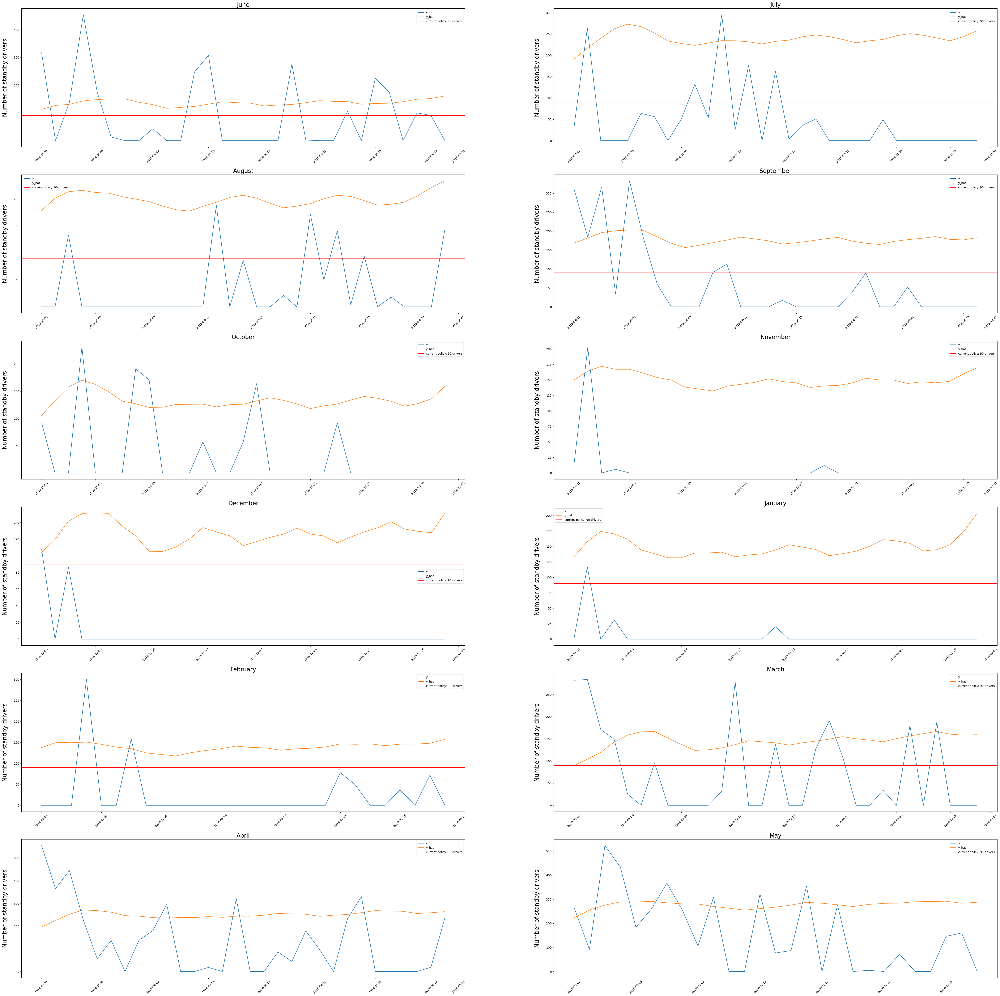

In [179]:
# tbats smoothed interval

forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
tbats_valid_oneday_interval_big_df = cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                         plotting = True, interval = 0.7) 

In [180]:
tbats_valid_oneday_interval_big = tbats_valid_oneday_interval_big_df["y_pred_list"].to_list()

Let's test different decision thresholds that appeared to lead to good peformance previously.

Historical data was added in the plots below to allow for a rough interpretation of why the combined model might behave the way it does.
Interestingly, it appears that the data distribution might shift for a few months, which might lead to the failure of the model in those months.
More on that will follow in a later notebook.

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -8.471675783770124
Number of additional underpredictions = -1
Number of additional sby drivers required = -7.953976204055252

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -0.462805404107975
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 9.143955036770652
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 5.027938992747252
Number of additional underpredictions = -3
Number of additional sby drivers required = -29.696616551871955

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -34.78810409133541
Number of additional underpredictions = -1
Nu

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -8.198009511038158
Number of additional underpredictions = -4
Number of additional sby drivers required = -47.54067038739234

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 7.899530525805893
Number of additional underpredictions = -7
Number of additional sby drivers required = -74.93033286457987


Mean efficiency loss per month in percent = -31.732367431179217
Mean number of additional underpredictions = -1.75
Mean number of additional sby drivers required = -29.756420779316386


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-8.471676,-1,-7.953976,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,-0.462805,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,9.143955,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,5.027939,-3,-29.696617,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-34.788104,-1,11.427946,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-59.275251,1,-87.649671,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-90.465950,1,26.974481,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[104.05103830253037, 119.66643386796027, 0.0, ...","[104.05103830253037, 119.66643386796027, 141.7...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-94.111464,1,-1.500000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 157.84775254635736, 0.0, 0.0, 0.0, 0.0, ...","[133.1416932119767, 157.84775254635736, 174.48...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-76.349206,4,-48.446278,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[137.6335203614402, 150.11200385972478, 0.0, 1...","[137.6335203614402, 150.11200385972478, 149.29...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-30.737367,-3,19.178035,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0, 9

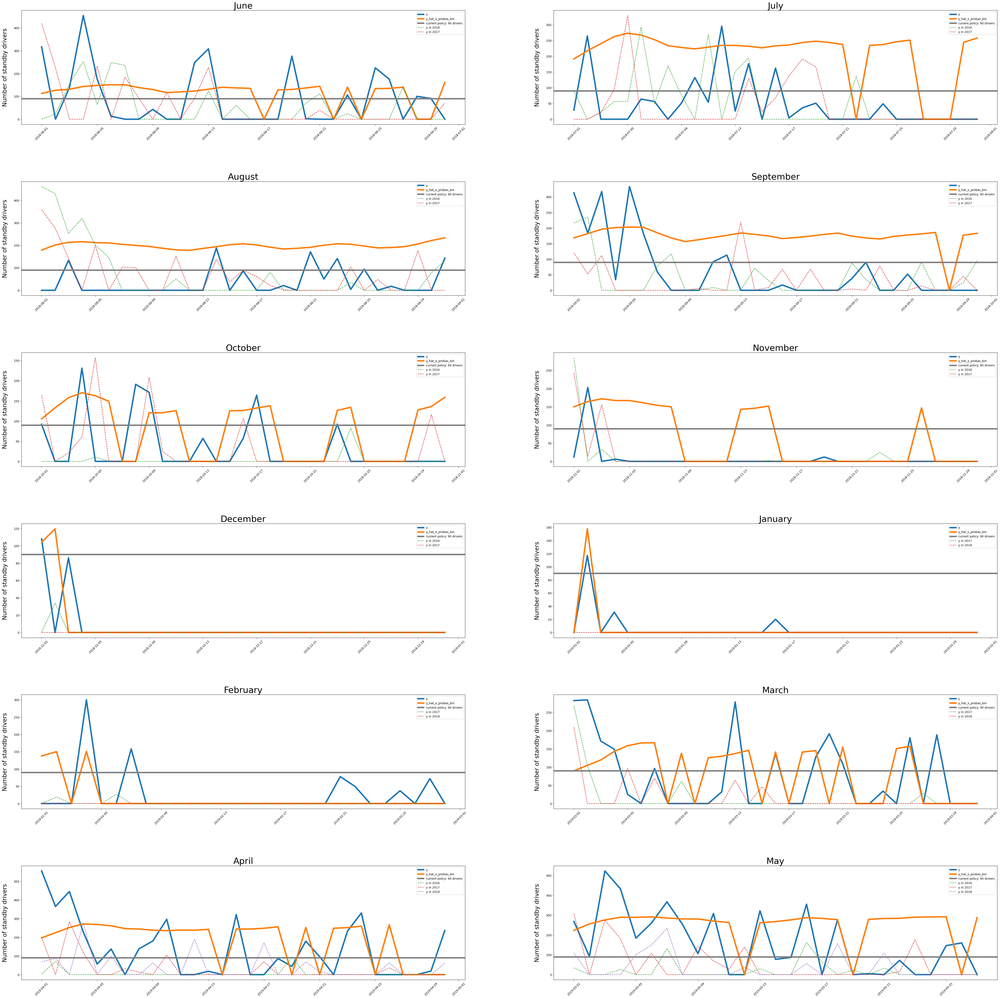

In [183]:
# decision threshold 0.1

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.1)

Before optimization:

Mean efficiency loss per month in percent = -30.369203982492234

Mean number of additional underpredictions = -1.8333333333333333

Mean number of additional sby drivers required = 5.389337822246681

(data copied from a previous notebook)

The optimization did not really improve the model for this threshold

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -15.138342450436788
Number of additional underpredictions = -1
Number of additional sby drivers required = -7.953976204055252

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -3.6886118557208754
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 3.0614435008459857
Number of additional underpredictions = -5
Number of additional sby drivers required = -34.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 5.027938992747252
Number of additional underpredictions = -3
Number of additional sby drivers required = -29.696616551871955

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -54.142942801012836
Number of additional underpredictions = -

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -14.714241298342891
Number of additional underpredictions = -2
Number of additional sby drivers required = -25.41641816356676

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 7.899530525805893
Number of additional underpredictions = -7
Number of additional sby drivers required = -74.93033286457987


Mean efficiency loss per month in percent = -37.45264161236488
Mean number of additional underpredictions = -1.5
Mean number of additional sby drivers required = -26.162733093997584


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-15.138342,-1,-7.953976,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,-3.688612,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,3.061444,-5,-34.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,5.027939,-3,-29.696617,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-54.142943,-1,11.427946,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-79.275251,1,-87.649671,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-90.465950,1,26.974481,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[104.05103830253037, 119.66643386796027, 0.0, ...","[104.05103830253037, 119.66643386796027, 141.7...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-94.111464,1,-1.500000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 157.84775254635736, 0.0, 0.0, 0.0, 0.0, ...","[133.1416932119767, 157.84775254635736, 174.48...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-79.920635,4,-48.446278,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 150.11200385972478, 0.0, 150.67766798508...","[137.6335203614402, 150.11200385972478, 149.29...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-33.963174,-3,19.178035,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0, 

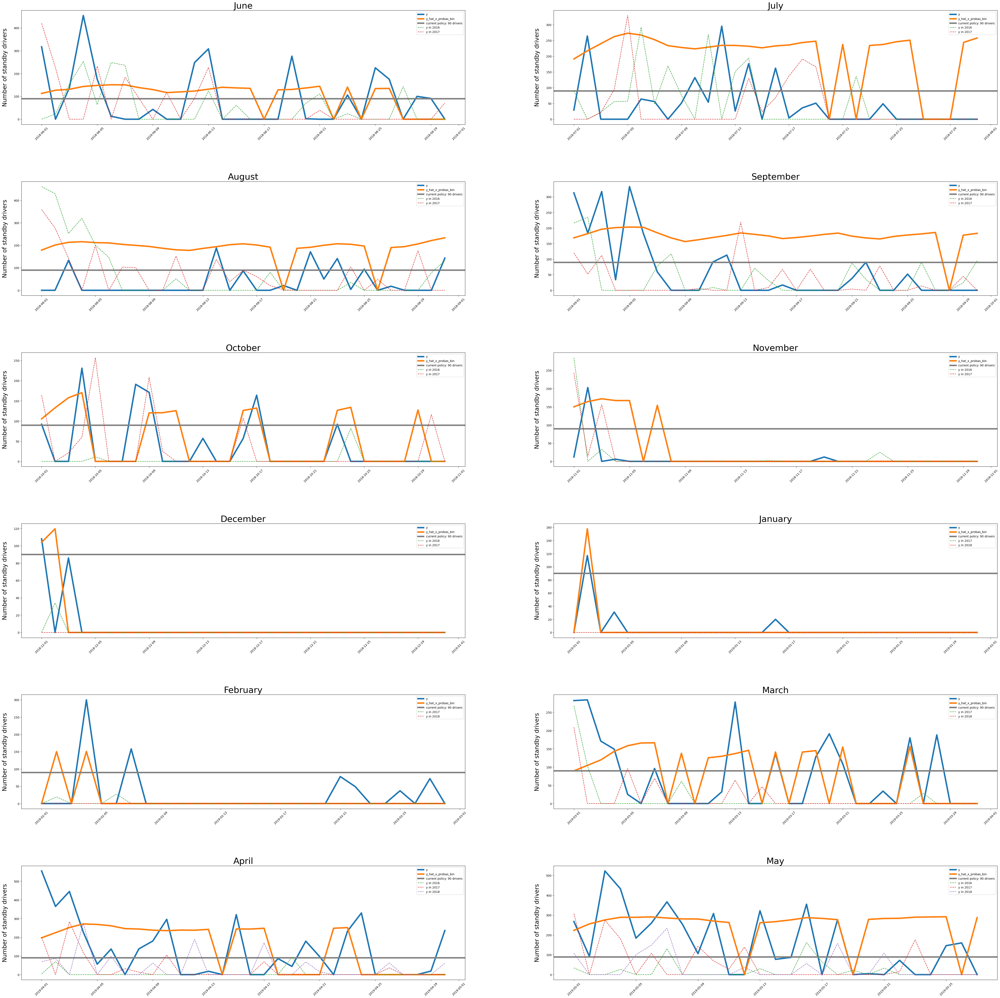

In [184]:
# decision threshold 0.15

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.15)

Before:

Mean efficiency loss per month in percent = -45.87092903748424

Mean number of additional underpredictions = -1.0833333333333333

Mean number of additional sby drivers required = -2.7046046860131843


The optimization reduced the efficiency but improved the additional number of underpredictions!

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -15.138342450436788
Number of additional underpredictions = -1
Number of additional sby drivers required = 4.235816549453546

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -6.914418307333779
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 1.8123988965828772
Number of additional underpredictions = -4
Number of additional sby drivers required = 27.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 1.6946056594139165
Number of additional underpredictions = -3
Number of additional sby drivers required = -29.696616551871955

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -64.70126933317565
Number of additional underpredictions = 0
Nu

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -14.961812085736007
Number of additional underpredictions = -1
Number of additional sby drivers required = -19.153616766369282

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 2.3442577291265962
Number of additional underpredictions = -6
Number of additional sby drivers required = -70.41955513888581


Mean efficiency loss per month in percent = -39.65507771321054
Mean number of additional underpredictions = -0.8333333333333334
Mean number of additional sby drivers required = -13.244961666632358


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-15.138342,-1,4.235817,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,-6.914418,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,1.812399,-4,27.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,1.694606,-3,-29.696617,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-64.701269,0,35.749297,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-79.275251,1,-87.649671,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-90.465950,1,26.974481,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[104.05103830253037, 119.66643386796027, 0.0, ...","[104.05103830253037, 119.66643386796027, 141.7...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[133.1416932119767, 157.84775254635736, 174.48...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-79.920635,4,-48.446278,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 150.11200385972478, 0.0, 150.67766798508...","[137.6335203614402, 150.11200385972478, 149.29...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-35.388280,0,35.406569,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0, 96.0

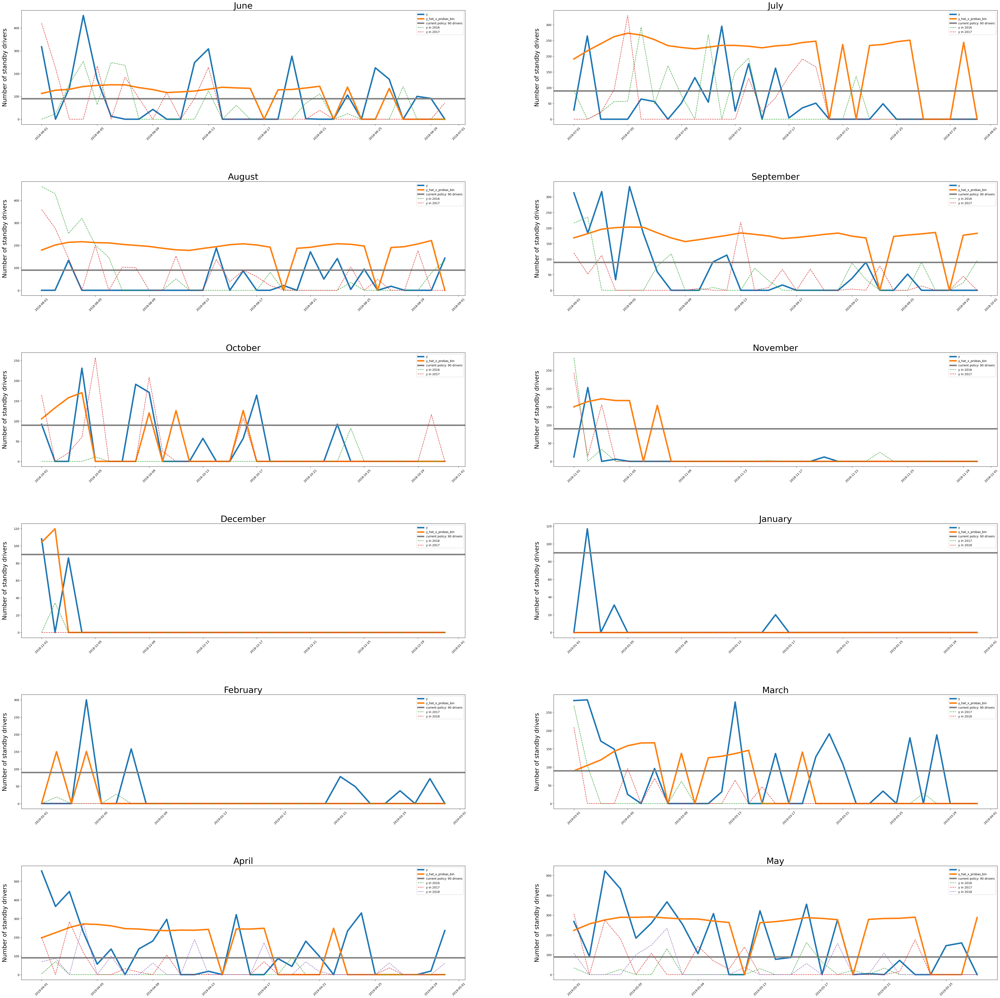

In [185]:
# decision threshold 0.2

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.2)

Before:

Mean efficiency loss per month in percent = -55.836853486616455

Mean number of additional underpredictions = -0.5

Mean number of additional sby drivers required = 0.6745215270220063


The optimization reduced the efficiency but improved the number of underpredictions!

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -19.29215066821648
Number of additional underpredictions = 0
Number of additional sby drivers required = 2.070331836999088

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -13.36603121055958
Number of additional underpredictions = -3
Number of additional sby drivers required = -61.93996515969005

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -1.4134075550300267
Number of additional underpredictions = -4
Number of additional sby drivers required = 27.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -1.638727673919412
Number of additional underpredictions = -3
Number of additional sby drivers required = -29.696616551871955

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -67.92707578478854
Number of additional underpredictions = 0
Num

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -41.839892930906586
Number of additional underpredictions = 0
Number of additional sby drivers required = 35.4065688680098

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -21.62847875240268
Number of additional underpredictions = -1
Number of additional sby drivers required = -19.153616766369282

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = -1.3594459745771132
Number of additional underpredictions = -6
Number of additional sby drivers required = -70.41955513888581


Mean efficiency loss per month in percent = -43.30169370221457
Mean number of additional underpredictions = -0.6666666666666666
Mean number of additional sby drivers required = -13.962927851135428


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-19.292151,0,2.070332,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[112.8460895678588, 126.91304523479164, 130.94...","[112.8460895678588, 126.91304523479164, 130.94...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,-13.366031,-3,-61.939965,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[191.0986669345912, 216.9187648795267, 239.549...","[191.0986669345912, 216.9187648795267, 239.549...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,-1.413408,-4,27.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[178.71020682896122, 201.2173588986177, 213.30...","[178.71020682896122, 201.2173588986177, 213.30...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,-1.638728,-3,-29.696617,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[168.46107719107692, 181.99356188952805, 196.2...","[168.46107719107692, 181.99356188952805, 196.2...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-67.927076,0,35.749297,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[105.46323246197007, 132.66846228785846, 157.7...","[105.46323246197007, 132.66846228785846, 157.7...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-85.822293,2,-94.099781,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[149.96043665649415, 164.29934299050566, 172.0...","[149.96043665649415, 164.29934299050566, 172.0...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-90.465950,1,26.974481,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[104.05103830253037, 119.66643386796027, 0.0, ...","[104.05103830253037, 119.66643386796027, 141.7...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[133.1416932119767, 157.84775254635736, 174.48...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-79.920635,4,-48.446278,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 150.11200385972478, 0.0, 150.67766798508...","[137.6335203614402, 150.11200385972478, 149.29...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-41.839893,0,35.406569,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0, 96

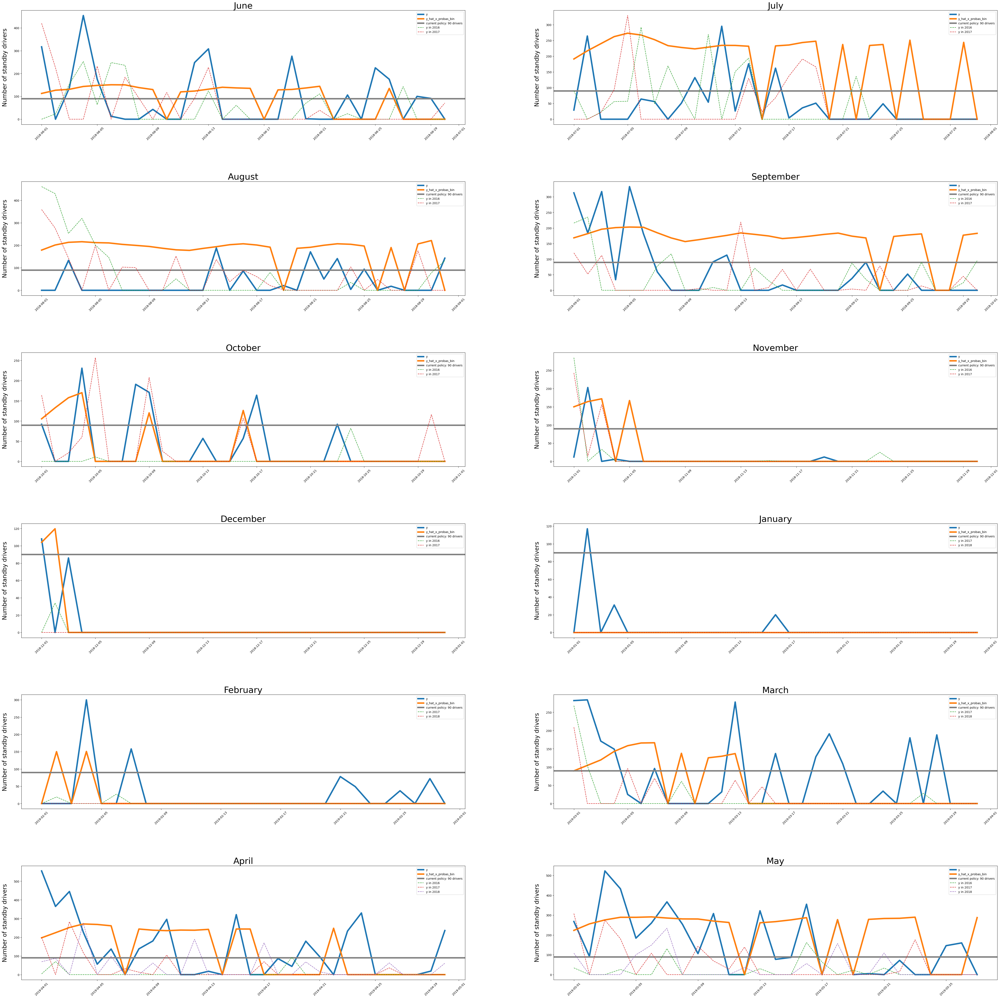

In [186]:
# decision threshold 0.25

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_big, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.25)

0.2 performs better than 0.25 when only considering the optimized versions.

Therefore, the comparison to an unoptimized version is a waste of time.


Looking at the graphs above, it appears that we have become better at predicting the occurrence of zeros in y.
However, when predicting a need for drivers, we are sometimes still undershooting despite using the upper bound of the prediction interval.
Therefore, it might become desirable to increase the prediction interval again.

This will reduce efficiency but lead to higher number of underpredictions prevented.

Maybe increasing the interval, but having a rather high decision threshold will lead to better performance.
Thereby, potentially, all the events with low probabilities could be excluded, such as those on weekends, while being able to compensate by having sufficient drivers for the rather regular but highly fluctuating driver requirements occurring at the beginning of the months/weeks. 

So let's increase the interval and check whether we can beat the previous models.

/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 5.856922067173187
Number of additional underpredictions = -4
Number of additional sby drivers required = -16.439726880043025


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 13.803691758353935
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 11.529391315884538
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning:

Mean of empty slice.

/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 10.495054556012832
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.814063427471368


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 4.066285786067276
Number of additional underpredictions = -3
Number of additional sby drivers required = -35.043412303146894


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for November
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.5476277711210344
Number of additional underpredictions = 0
Number of additional sby drivers required = -98.45224502806619


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for December
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 1.8730418517048664
Number of additional underpredictions = -1
Number of additional sby drivers required = -18.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning:

Mean of empty slice.

/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for January
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 2.09531914774213
Number of additional underpredictions = -1
Number of additional sby drivers required = -27.0


/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning:

Mean of empty slice.

/home/marvin/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning:

invalid value encountered in double_scalars

/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for February
Forecasting for 28 days
Number of leading days: 16
Loss in efficiency = 4.807501183061062
Number of additional underpredictions = -1
Number of additional sby drivers required = -14.314070568573754


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = 6.746415922383825
Number of additional underpredictions = -7
Number of additional sby drivers required = 3.9511857716848198


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 15.7295999152024
Number of additional underpredictions = -8
Number of additional sby drivers required = -54.98520565845952


/tmp/ipykernel_12632/167320444.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 19.233509434696295
Number of additional underpredictions = -8
Number of additional sby drivers required = -111.56829502642968


Mean efficiency loss per month in percent = 8.065363392450282
Mean number of additional underpredictions = -3.8333333333333335
Mean number of additional sby drivers required = -44.69095750172162


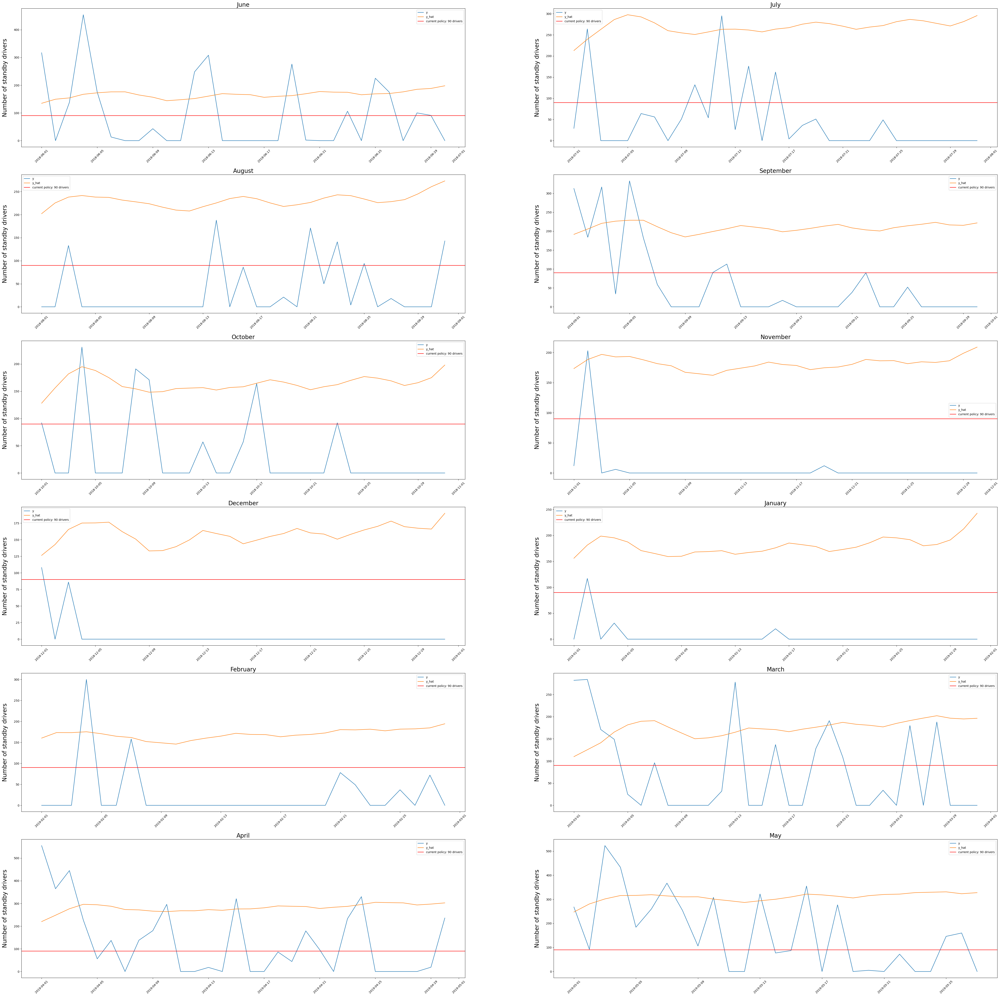

In [188]:
# tbats smoothed interval

forecaster = TBATS(sp = [365.25, 30.4375, 7],
                  use_box_cox = False,
                  use_trend = False,
                  use_damped_trend = False,
                  use_arma_errors = False,
                  n_jobs = -1)
                    
tbats_valid_oneday_interval_bigger_df = cv_sktime_models_one_year(model = forecaster, 
         statsforecast_df = data, 
         splits_dict = year_split, 
         custom_scorer = interpretable_scores,
                        transformer = None,
                          smoothing = "MA_oneday",
                         plotting = True, interval = 0.8) 

In [189]:
tbats_valid_oneday_interval_bigger = tbats_valid_oneday_interval_bigger_df["y_pred_list"].to_list()

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -0.731141885688217
Number of additional underpredictions = -2
Number of additional sby drivers required = -19.60178150403442

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 7.352078855128127
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 11.529391315884538
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 10.495054556012832
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.814063427471368

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -15.288552923610137
Number of additional underpredictions = -3


/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 19.233509434696295
Number of additional underpredictions = -8
Number of additional sby drivers required = -111.56829502642968


Mean efficiency loss per month in percent = -20.12133968998669
Mean number of additional underpredictions = -2.8333333333333335
Mean number of additional sby drivers required = -45.781693430250165


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-0.731142,-2,-19.601782,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,7.352079,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,11.529391,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,10.495055,-4,-21.814063,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-15.288553,-3,-35.043412,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-25.890030,1,-99.726123,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-81.997926,-1,-18.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[126.30836637592972, 142.6633850027554, 165.42...","[126.30836637592972, 142.6633850027554, 165.42...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-90.574951,1,-1.500000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[155.99862419666243, 181.42307909002525, 0.0, ...","[155.99862419666243, 181.42307909002525, 198.7...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-69.206349,4,-52.552345,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[160.21079814314908, 173.39640933828974, 173.2...","[160.21079814314908, 173.39640933828974, 173.2...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-15.440093,-5,8.036561,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.

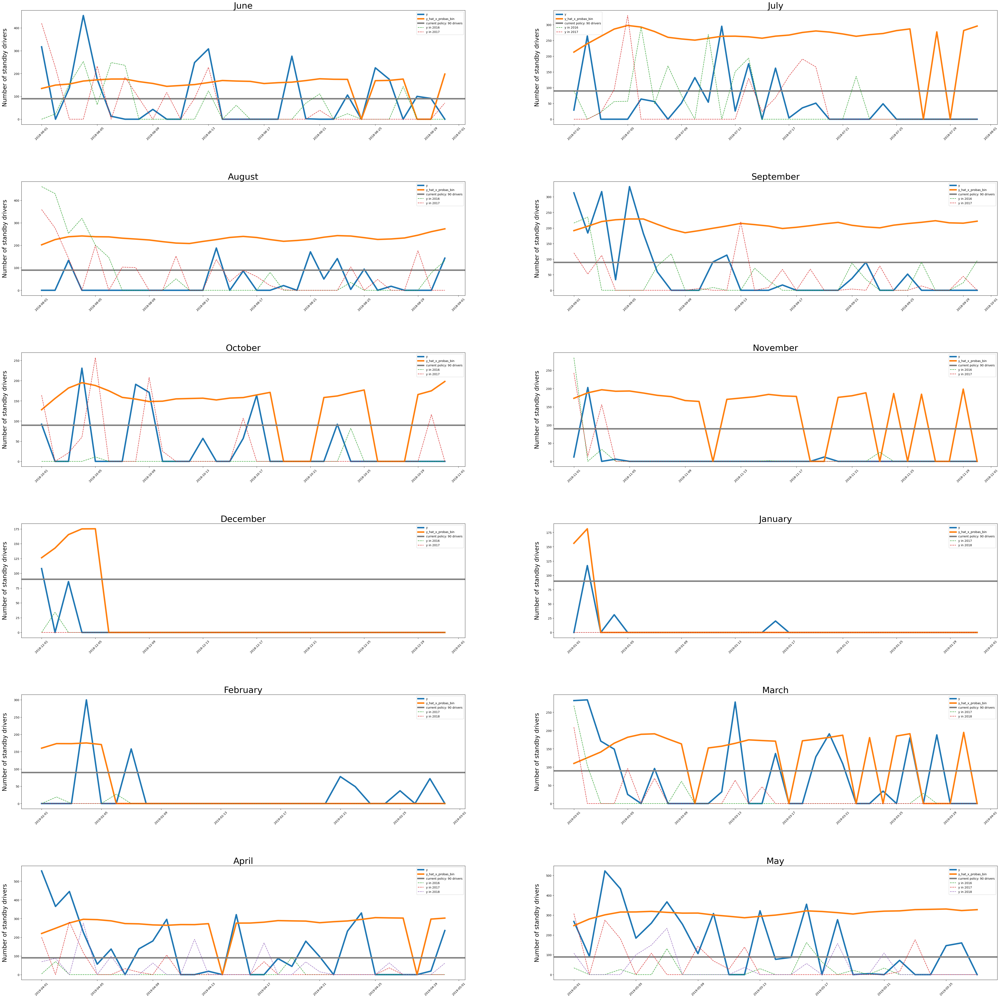

In [195]:
# decision threshold 0.05

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.05)

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -7.397808552354881
Number of additional underpredictions = -2
Number of additional sby drivers required = -19.60178150403442

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = 0.9004659519023193
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 11.529391315884538
Number of additional underpredictions = -6
Number of additional sby drivers required = -55.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 7.1617212226795
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.814063427471368

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -33.46930997978296
Number of additional underpredictions = -2
Num

/tmp/ipykernel_12632/825272837.py:112: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:113: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:114: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykerne


Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -6.462331142023409
Number of additional underpredictions = -4
Number of additional sby drivers required = -64.29112339507572

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 9.956494855103557
Number of additional underpredictions = -7
Number of additional sby drivers required = -100.16392481479264


Mean efficiency loss per month in percent = -30.45803266909918
Mean number of additional underpredictions = -2.25
Mean number of additional sby drivers required = -32.54193499718338


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-7.397809,-2,-19.601782,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,0.900466,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,11.529391,-6,-55.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,7.161721,-4,-21.814063,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-33.469310,-2,9.852421,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-59.223363,1,-99.726123,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-89.998370,0,68.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[126.30836637592972, 142.6633850027554, 0.0, 0...","[126.30836637592972, 142.6633850027554, 165.42...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-93.800757,1,-1.500000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 181.42307909002525, 0.0, 0.0, 0.0, 0.0, ...","[155.99862419666243, 181.42307909002525, 198.7...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-76.349206,4,-52.552345,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[160.21079814314908, 173.39640933828974, 0.0, ...","[160.21079814314908, 173.39640933828974, 173.2...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-28.343319,-5,33.919377,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0, 9

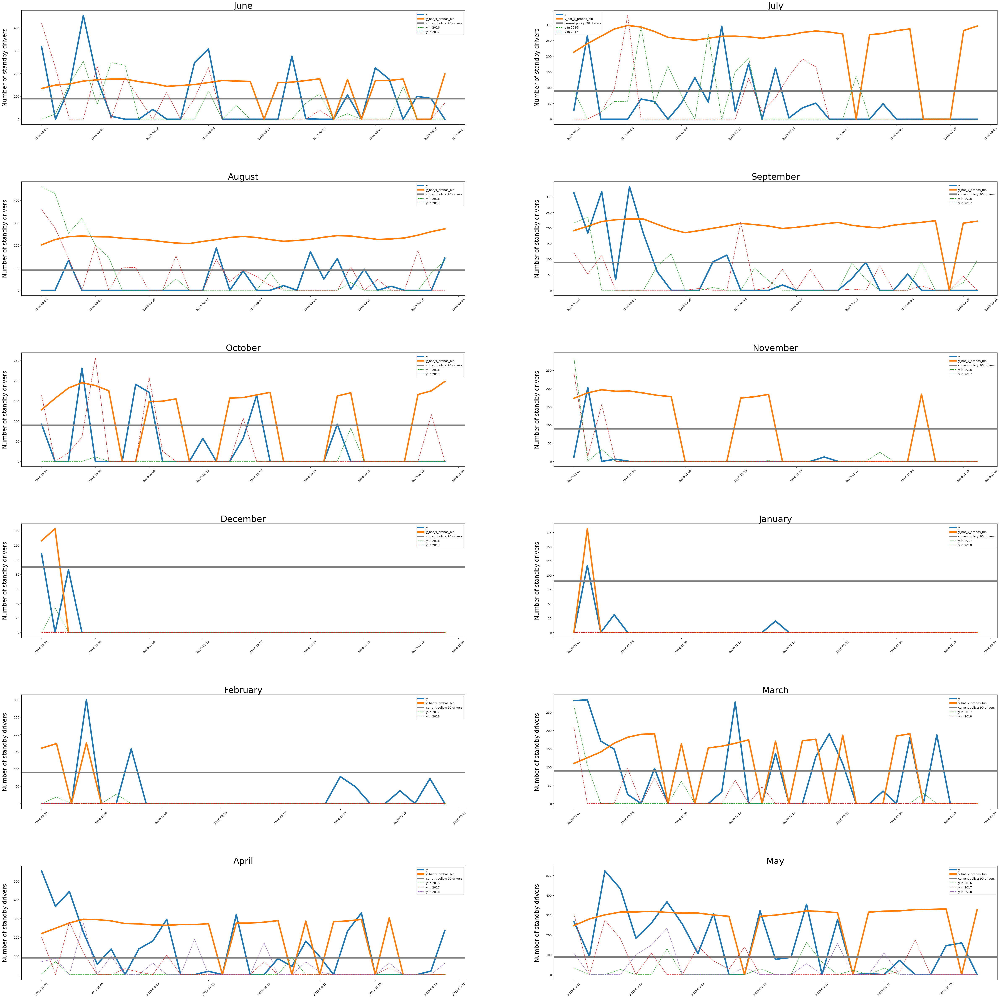

In [194]:
# decision threshold 0.1

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.1)

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -14.064475219021553
Number of additional underpredictions = -2
Number of additional sby drivers required = -19.60178150403442

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -2.325340499710581
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 5.388744913123787
Number of additional underpredictions = -5
Number of additional sby drivers required = -34.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 7.1617212226795
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.814063427471368

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -52.82414868946039
Number of additional underpredictions = -2
Num

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for March
Forecasting for 31 days
Number of leading days: 13
Loss in efficiency = -31.569125582203966
Number of additional underpredictions = -5
Number of additional sby drivers required = 33.91937689759706

Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -13.388265286812775
Number of additional underpredictions = -2
Number of additional sby drivers required = -36.373530072376155

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 9.956494855103557
Number of additional underpredictions = -7
Number of additional sby drivers required = -100.16392481479264


Mean efficiency loss per month in percent = -36.21729328564489
Mean number of additional underpredictions = -2.0
Mean number of additional sby drivers required = -28.465468886958423


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-14.064475,-2,-19.601782,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,-2.325340,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,5.388745,-5,-34.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,7.161721,-4,-21.814063,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-52.824149,-2,9.852421,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-79.223363,1,-99.726123,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-89.998370,0,68.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[126.30836637592972, 142.6633850027554, 0.0, 0...","[126.30836637592972, 142.6633850027554, 165.42...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-93.800757,1,-1.500000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 181.42307909002525, 0.0, 0.0, 0.0, 0.0, ...","[155.99862419666243, 181.42307909002525, 198.7...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-79.920635,4,-52.552345,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 173.39640933828974, 0.0, 175.31407056857...","[160.21079814314908, 173.39640933828974, 173.2...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-31.569126,-5,33.919377,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0, 

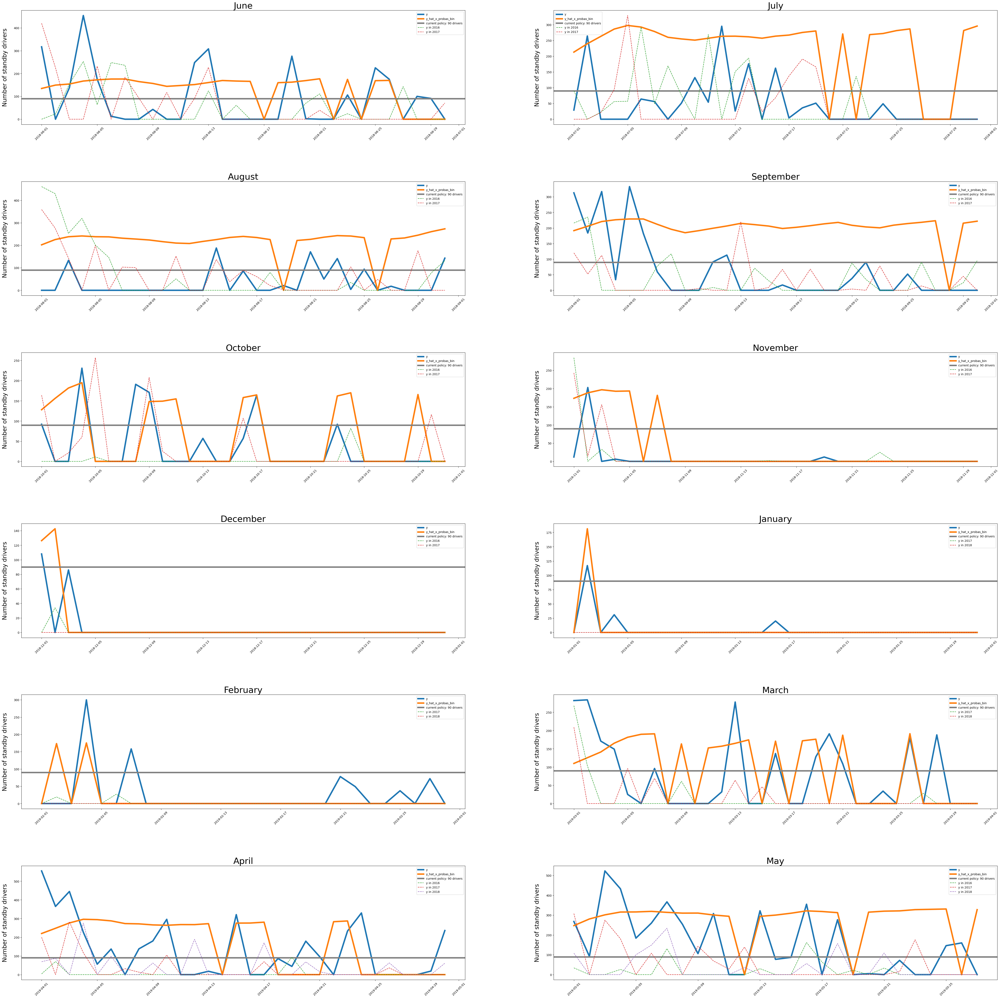

In [190]:
# decision threshold 0.15

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.15)

The optimized version above had 

Mean efficiency loss per month in percent = -37.45264161236488
Mean number of additional underpredictions = -1.5
Mean number of additional sby drivers required = -26.162733093997584

which is very close. 


/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -14.064475219021553
Number of additional underpredictions = -2
Number of additional sby drivers required = -2.7271275456833166

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -5.551146951323485
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 3.850937126528546
Number of additional underpredictions = -4
Number of additional sby drivers required = 27.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 3.8283878893461676
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.814063427471368

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -63.91042330987132
Number of additional underpredictions = 0
N

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -14.017763192842288
Number of additional underpredictions = -1
Number of additional sby drivers required = -29.267873912962585

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 4.182928292288786
Number of additional underpredictions = -6
Number of additional sby drivers required = -92.84941465018605


Mean efficiency loss per month in percent = -38.699795455381924
Mean number of additional underpredictions = -1.1666666666666667
Mean number of additional sby drivers required = -16.448667747492166


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-14.064475,-2,-2.727128,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,-5.551147,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,3.850937,-4,27.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,3.828388,-4,-21.814063,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-63.910423,0,26.957169,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-79.223363,1,-99.726123,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-89.998370,0,68.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[126.30836637592972, 142.6633850027554, 0.0, 0...","[126.30836637592972, 142.6633850027554, 165.42...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[155.99862419666243, 181.42307909002525, 198.7...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-79.920635,4,-52.552345,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 173.39640933828974, 0.0, 175.31407056857...","[160.21079814314908, 173.39640933828974, 173.2...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-34.627386,-1,38.221422,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0, 96

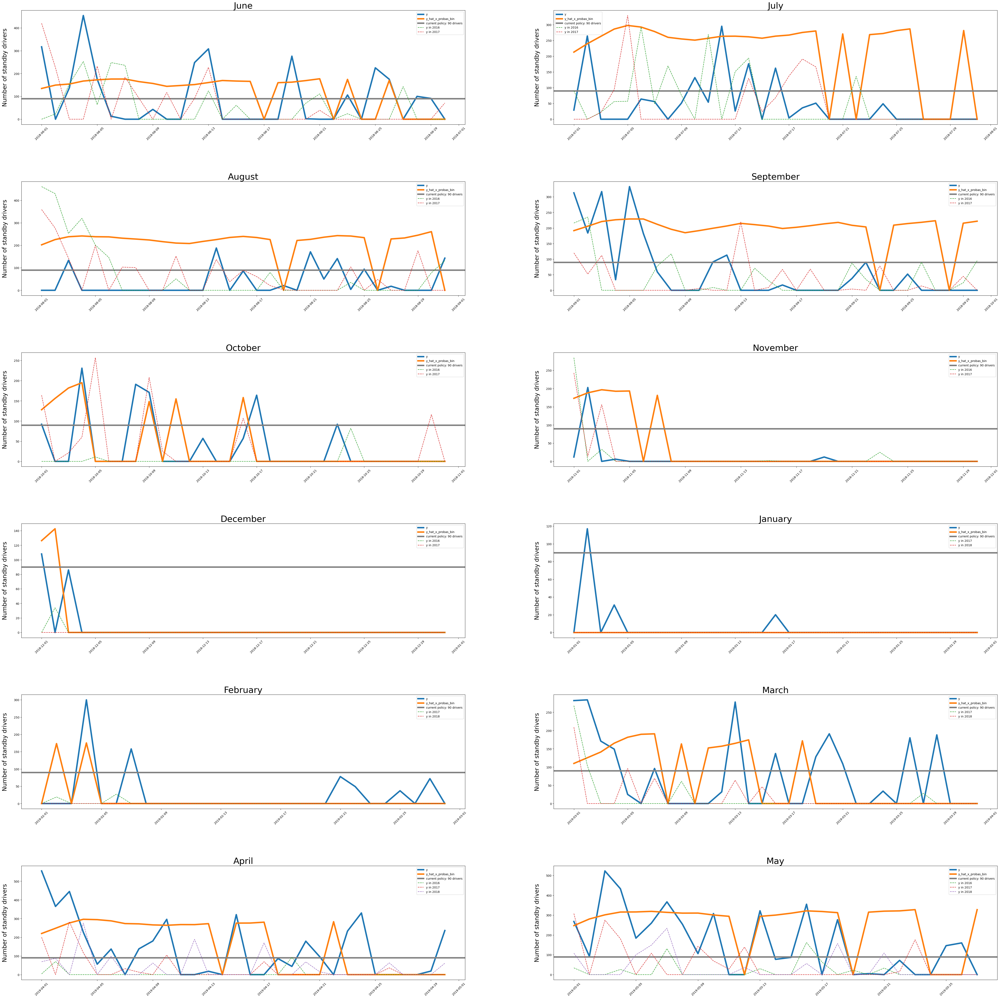

In [191]:
# decision threshold 0.2

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.2)

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -18.704843977689258
Number of additional underpredictions = -1
Number of additional sby drivers required = -4.456479586984827

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -12.002759854549286
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394


/tmp/ipykernel_12632/825272837.py:112: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:113: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:114: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykerne


Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = 0.625130674915642
Number of additional underpredictions = -4
Number of additional sby drivers required = 27.0

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = 0.4950545560128319
Number of additional underpredictions = -4
Number of additional sby drivers required = -21.814063427471368

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -67.13622976148422
Number of additional underpredictions = 0
Number of additional sby drivers required = 26.957169413239427

Split for November
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -85.78626572783286
Number of additional underpredictions = 2
Number of additional sby drivers required = -102.15074834268873

Split for December
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -89.998369975775
Number of additional underpredictions = 

/tmp/ipykernel_12632/825272837.py:112: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:113: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:114: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy




Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = 0.4792245885850832
Number of additional underpredictions = -6
Number of additional sby drivers required = -92.84941465018605


Mean efficiency loss per month in percent = -42.38827994705665
Mean number of additional underpredictions = -1.0
Mean number of additional sby drivers required = -16.794832569988596


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-18.704844,-1,-4.456480,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,-12.002760,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,0.625131,-4,27.000000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,0.495055,-4,-21.814063,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-67.136230,0,26.957169,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-85.786266,2,-102.150748,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-89.998370,0,68.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[126.30836637592972, 142.6633850027554, 0.0, 0...","[126.30836637592972, 142.6633850027554, 165.42...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[155.99862419666243, 181.42307909002525, 198.7...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-79.920635,4,-52.552345,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 173.39640933828974, 0.0, 175.31407056857...","[160.21079814314908, 173.39640933828974, 173.2...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-41.078999,-1,38.221422,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0, 

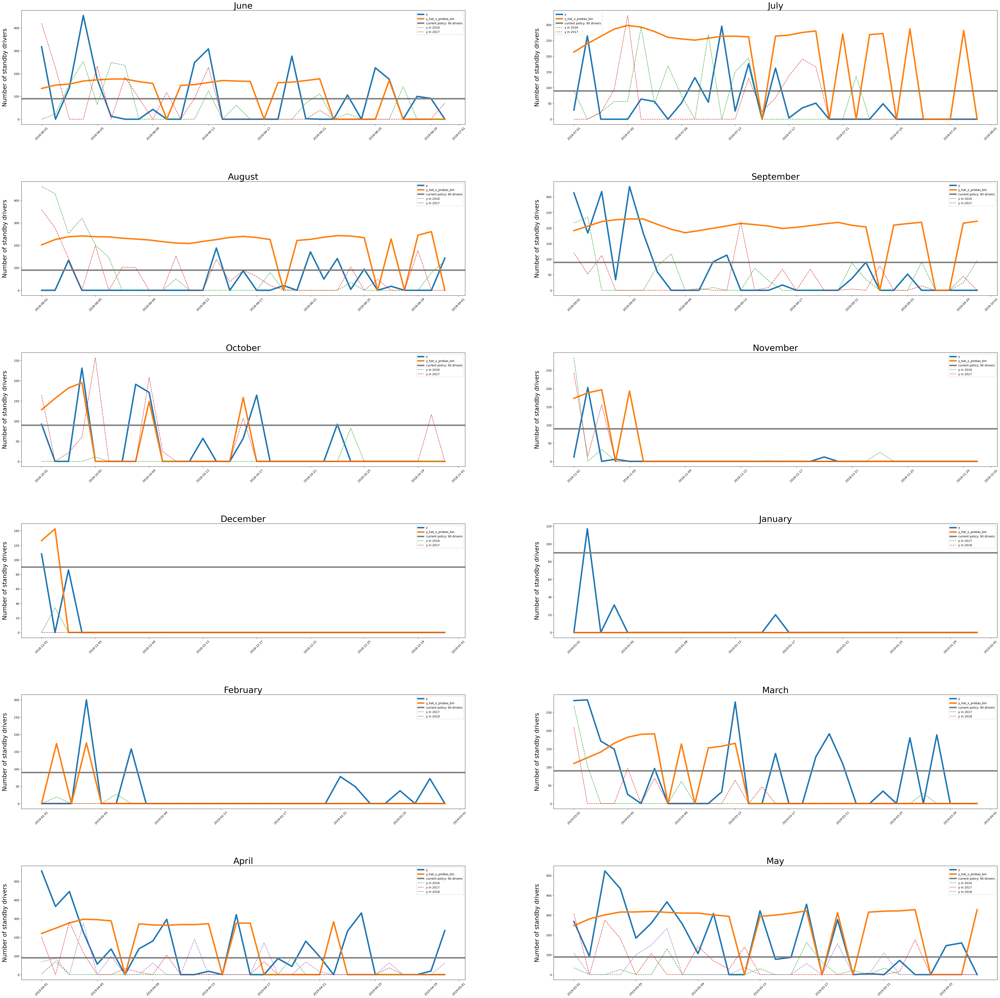

In [192]:
# decision threshold 0.25

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.25)

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:86: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_1


Split for June
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -21.998760005791205
Number of additional underpredictions = 0
Number of additional sby drivers required = -14.564272954736097

Split for July
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -15.22856630616219
Number of additional underpredictions = -3
Number of additional sby drivers required = -87.62565690015394

Split for August
Forecasting for 31 days
Number of leading days: 16
Loss in efficiency = -8.744427541129863
Number of additional underpredictions = -2
Number of additional sby drivers required = -8.5

Split for September
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -2.55275560664181
Number of additional underpredictions = -3
Number of additional sby drivers required = -44.36054757060353

Split for October
Forecasting for 31 days
Number of leading days: 15
Loss in efficiency = -69.19959442978042
Number of additional underpredictions = 1
Num

/tmp/ipykernel_12632/825272837.py:114: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:84: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_12632/825272837.py:85: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_


Split for April
Forecasting for 30 days
Number of leading days: 16
Loss in efficiency = -27.35109652617563
Number of additional underpredictions = -1
Number of additional sby drivers required = -29.267873912962585

Split for May
Forecasting for 27 days
Number of leading days: 15
Loss in efficiency = -2.816507314410657
Number of additional underpredictions = -4
Number of additional sby drivers required = -77.02830895621283


Mean efficiency loss per month in percent = -45.285260553283365
Mean number of additional underpredictions = -0.3333333333333333
Mean number of additional sby drivers required = -12.906408571873166


,efficiency_losses,num_undershoots,magnitude_undershoots,y_trues_list,y_preds_list,y_uncorr_preds_list,X_tests,y_tests,dates_list,feature_names_list,test_df
0,-21.998760,0,-14.564273,"[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[134.6279528577888, 149.39122224699878, 154.08...","[134.6279528577888, 149.39122224699878, 154.08...","[[4, 1, 6, False, False, 2, 1], [5, 2, 6, True...","[317.0, 0.0, 138.0, 454.0, 175.0, 13.0, 0.0, 0...","[2018-06-01T00:00:00.000000000, 2018-06-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
1,-15.228566,-3,-87.625657,"[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[212.9308632970006, 239.47877770481944, 262.81...","[212.9308632970006, 239.47877770481944, 262.81...","[[6, 1, 7, True, False, 2, 1], [0, 2, 7, False...","[29.0, 264.0, 0.0, 0.0, 0.0, 64.0, 56.0, 0.0, ...","[2018-07-01T00:00:00.000000000, 2018-07-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
2,-8.744428,-2,-8.500000,"[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[202.13767567798723, 225.38095361908586, 238.1...","[202.13767567798723, 225.38095361908586, 238.1...","[[2, 1, 8, False, True, 2, 1], [3, 2, 8, False...","[0.0, 0.0, 133.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0...","[2018-08-01T00:00:00.000000000, 2018-08-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
3,-2.552756,-3,-44.360548,"[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[191.60606886730318, 205.8687715444591, 220.82...","[191.60606886730318, 205.8687715444591, 220.82...","[[5, 1, 9, True, False, 3, 1], [6, 2, 9, True,...","[313.0, 184.0, 317.0, 34.0, 333.0, 182.0, 59.0...","[2018-09-01T00:00:00.000000000, 2018-09-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
4,-69.199594,1,70.738095,"[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[128.03724170954473, 155.9927492372653, 181.81...","[128.03724170954473, 155.9927492372653, 181.81...","[[0, 1, 10, False, False, 3, 1], [1, 2, 10, Fa...","[92.0, 0.0, 0.0, 231.0, 0.0, 0.0, 0.0, 191.0, ...","[2018-10-01T00:00:00.000000000, 2018-10-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
5,-89.119599,2,-102.150748,"[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[173.37770417821216, 188.4522450280662, 196.89...","[173.37770417821216, 188.4522450280662, 196.89...","[[3, 1, 11, False, True, 3, 1], [4, 2, 11, Fal...","[12.0, 203.0, 0.0, 6.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-11-01T00:00:00.000000000, 2018-11-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
6,-90.465950,1,79.000000,"[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 142.6633850027554, 0.0, 0.0, 0.0, 0.0, 0...","[126.30836637592972, 142.6633850027554, 165.42...","[[5, 1, 12, True, False, 4, 1], [6, 2, 12, Tru...","[108.0, 0.0, 86.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0....","[2018-12-01T00:00:00.000000000, 2018-12-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
7,-94.946237,2,29.000000,"[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[155.99862419666243, 181.42307909002525, 198.7...","[[1, 1, 1, False, True, 4, 1], [2, 2, 1, False...","[0.0, 117.0, 0.0, 31.0, 0.0, 0.0, 0.0, 0.0, 0....","[2019-01-01T00:00:00.000000000, 2019-01-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
8,-79.920635,4,-23.333333,"[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[0.0, 173.39640933828974, 0.0, 0.0, 0.0, 0.0, ...","[160.21079814314908, 173.39640933828974, 173.2...","[[4, 1, 2, False, False, 4, 1], [5, 2, 2, True...","[0.0, 0.0, 0.0, 300.0, 0.0, 0.0, 158.0, 0.0, 0...","[2019-02-01T00:00:00.000000000, 2019-02-02T00:...","[weekday, day_of_month, month, is_weekend, kid...",ds y sby_required weekday ...
9,-41.078999,-1,53.215744,"[282.0, 284.0, 171.0, 149.0, 25.0, 0.0

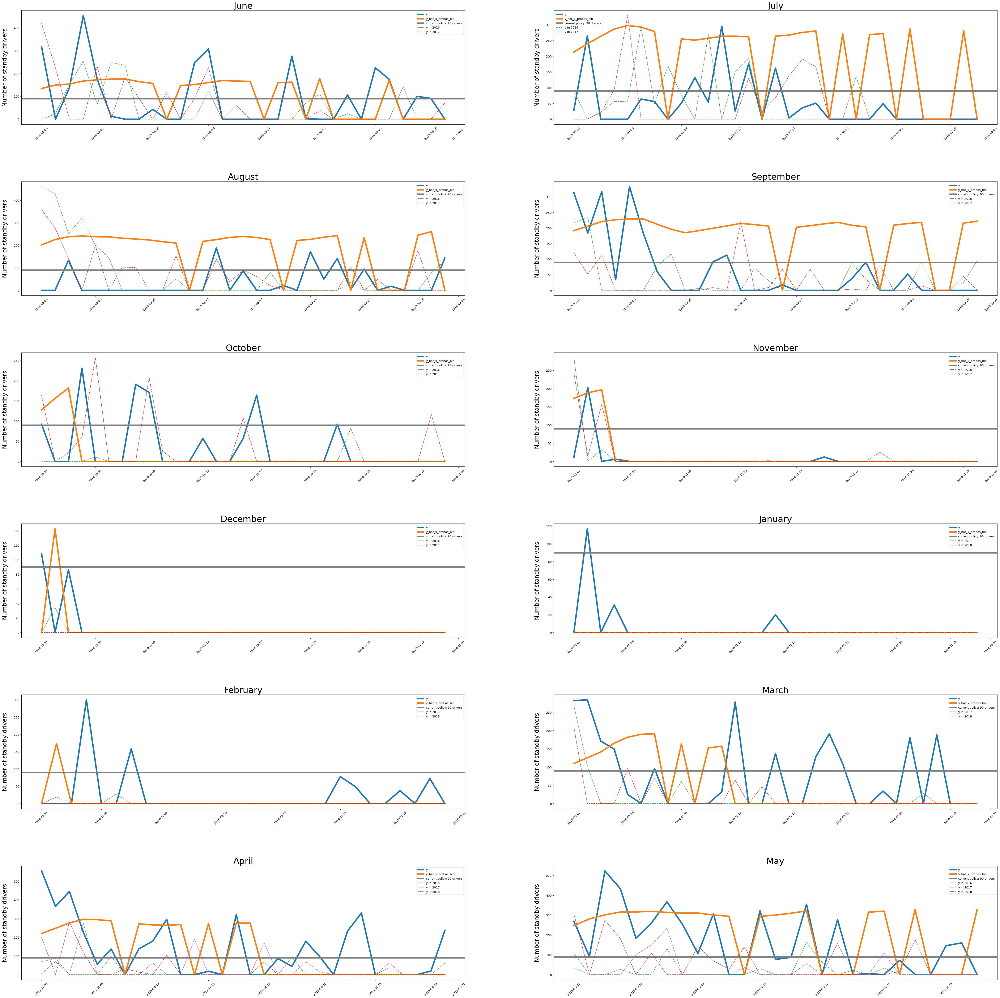

In [193]:
# decision threshold 0.3

combine_clf_reg(dropped_df, clf_probas, tbats_valid_oneday_interval_bigger, year_split, interpretable_scores, plotting = True,
                     print_per_month = True, print_mean = True, smoothing = None, decision_thr = 0.3)

The .15 threshold of the model before optimization had :

Mean efficiency loss per month in percent = -45.87092903748424. 
Mean number of additional underpredictions = -1.0833333333333333. 
Mean number of additional sby drivers required = -2.7046046860131843. 

So this model here is worse in all regards.


In the end, it really comes down to what is more important: having more underpredictions vs being more efficient.
It is probably best to prepare several models for shipment, and then the client can choose.


one that has higher efficiency 

Params: EBM before optimization, interval 0.7, threshold 0.2:
Mean efficiency loss per month in percent = -55.836853486616455.
Mean number of additional underpredictions = -0.5. 
Mean number of additional sby drivers required = 0.6745215270220063. 



and one that has higher additional underpredictions:

optimized EBM, interval 0.8, threshold 0.15:
Mean efficiency loss per month in percent = -36.21729328564489.
Mean number of additional underpredictions = -2.0.
Mean number of additional sby drivers required = -28.465468886958423.



even higher additional underpredictions can be achieved in the same model using lower thresholds:

0.05
Mean efficiency loss per month in percent = -20.12133968998669. 
Mean number of additional underpredictions = -2.8333333333333335. 
Mean number of additional sby drivers required = -45.781693430250165.


0.1
Mean efficiency loss per month in percent = -30.45803266909918.
Mean number of additional underpredictions = -2.25.
Mean number of additional sby drivers required = -32.54193499718338.

However, decreasing mean additional underpredictions by not even 1 full underprediction prevented leads to a quite profound decrease in efficiency gained, so personally I would go with the -36/-2 model (optimized EBM, interval 0.8, threshold 0.5).

Furthermore, that model also reduces the number of additional sby drivers required in those cases where we were underpredicting in general.

Next, since only the EBM classifier had been tested so far, at least one other classifier should be investigated for its performance on this dataset.
For that matter, I wanted to test a support vector machine (SVM) classifier as SVMs in general are praised oftentimes for their performance abilities thanks to their abundance of parameters that can be tweaked according to the dataset.

Thus, the story continues in the SVC_hyperparameter_tuning notebook.
